In [1]:
import pandas as pd
import seaborn as sns
import numpy as np
import csv
from matplotlib import pyplot as plt
import matplotlib 
import datetime

%matplotlib inline


In [2]:
names=["num","date_arrivee","moyen_arrivee","motif_entree","motif_venue","age","antecedents_medicaux","antecedents_chirurgicaux","pas_pad","fc","temperature","sao2","fr","ccmu","salles","entree_box","anamnese","observation","exam_biologie","exam_radiologie","exam_radiographie","exam_scanner","exam_irm","exam_avis_specialiste","date_presc_bio","date_bio","code_diag","diag_texte","cac_admission","cac_sejour","date_sortie","date_prise_charge","dossier","type_orientation","or_destination","or_trsfert_service","or_trsfert_hop","code_postal","ville"]

In [3]:
df = pd.read_csv("C:/Users/Tom/Desktop/Work Centrale/G2/IAS/Fil rouge/Cours_Filrouge_BDD/BDD_urgences juin 2016 juin 2020.csv", on_bad_lines = 'skip', sep=';', dtype=str,names=names)

In [4]:
df.shape

(336254, 39)

In [5]:
df = df.drop(0)
df = df.drop(["num"],axis=1)

In [6]:
df.head(5)

,date_arrivee,moyen_arrivee,motif_entree,motif_venue,age,antecedents_medicaux,antecedents_chirurgicaux,pas_pad,fc,temperature,...,cac_sejour,date_sortie,date_prise_charge,dossier,type_orientation,or_destination,or_trsfert_service,or_trsfert_hop,code_postal,ville
1,01/06/2016 00:16,AMBULANCE PRIVEE,"Malaise, difficulté respi, palpitation, Pas de...",Cardiologie: Palpitations Malaise,33,NaN,NaN,110/56,52,"34,9",...,3093,01/06/2016 04:14,01/06/2016 01:03,NaN,RETOUR DOMICILE,RETOUR DOMICILE,NaN,NaN,59139,WATTIGNIES
2,01/06/2016 00:18,AMBULANCE PRIVEE,"AEG, Hyperthermie et difficulté respi en maiso...",Maladies infectieuses: Hyperthermie,78,NaN,NaN,90/41,77,"36,3",...,3102,01/06/2016 11:05,01/06/2016 02:14,NaN,TRANSFERT EXTERNE,Transfert CLINIQUE DUBOIS (LILLE) Motif: Conve...,NaN,CLINIQUE DUBOIS,59310,ORCHIES
3,01/06/2016 00:36,POMPIERS,NaN,NaN,77,NaN,NaN,137/77,97,"36,5",...,3102,01/06/2016 03:04,NaN,NaN,TRANSFERT INTERNE,Admis(e) en NEUROLOGIE B 5 EST (3281/CAC),NEUROLOGIE B 5 EST,NaN,59480,LA BASSEE
4,01/06/2016 00:43,MOYENS PERSONNELS,"1A, Hyperthermie ne cédant pas au paracetamol,...",Maladies infectieuses: Hyperthermie,38,NaN,NaN,117/71,118,"38,2",...,3093,01/06/2016 04:50,01/06/2016 01:57,NaN,RETOUR DOMICILE,RETOUR DOMICILE,NaN,NaN,59136,WAVRIN
5,01/06/2016 01:16,AMBULANCE PRIVEE,"Douleur bras gauche et mollet gauche, hémiplég...",Cardiologie: Phlébite,69,décembre 2007 : infarctus capsulo caudé droit ...,NaN,137/79,70,"36,1",...,3102,01/06/2016 15:55,01/06/2016 02:35,NaN,RETOUR DOMICILE,RETOUR DOMICILE,NaN,NaN,59130,LAMBERSART


<font color='RED'><font size='6'> DATA CLEANUP</font>


In [7]:
df["age"] = pd.to_numeric(df.age)

In [8]:
df.age.describe()

count    336253.000000
mean         44.633229
std          21.182535
min          15.000000
25%          26.000000
50%          40.000000
75%          60.000000
max         218.000000
Name: age, dtype: float64

Il va falloir drop les valeurs d'age supérieures à 120 par ex

In [9]:
df["date_arrivee"] = pd.to_datetime(df.date_arrivee,format="%d/%m/%Y %H:%M")
df["date_sortie"] = pd.to_datetime(df.date_sortie,format="%d/%m/%Y %H:%M")

In [10]:
df["date_prise_charge"] = pd.to_datetime(df.date_prise_charge,format="%d/%m/%Y %H:%M")

In [11]:
df["duree_sejour"] = df["date_sortie"] - df["date_arrivee"]

In [12]:
df["duree_attente"] = df["date_prise_charge"]- df["date_arrivee"]

In [13]:
df["duree_traitement"] = df["duree_sejour"]-df["duree_attente"]

In [14]:
df["count"]=1

In [15]:
df.date_arrivee.describe(datetime_is_numeric=True)
df.date_sortie.describe(datetime_is_numeric=True)
df.duree_attente.describe(datetime_is_numeric=True)

count                       298023
mean     0 days 01:59:07.350842049
std      0 days 03:20:24.282881410
min                0 days 00:00:00
25%                0 days 00:43:00
50%                0 days 01:23:00
75%                0 days 02:37:00
max               48 days 05:29:00
Name: duree_attente, dtype: object

In [16]:
df["nb_exam"] = (df["exam_biologie"] == "oui")*1 + (df["exam_radiologie"] == "oui")*1 +(df["exam_radiographie"] == "oui")*1 + (df["exam_scanner"] == "oui")*1 + (df["exam_irm"] == "oui")*1 +(df["exam_avis_specialiste"] == "oui")*1 



In [17]:
pd.pivot_table(df,index=df['date_arrivee'].dt.month,columns=df['date_arrivee'].dt.year,
               values='age',aggfunc='count')

date_arrivee,2016,2017,2018,2019,2020
date_arrivee,,,,,
1,NaN,6961.0,7522.0,7229.0,7213.0
2,NaN,6465.0,6607.0,6795.0,6825.0
3,NaN,7468.0,7511.0,7656.0,4997.0
4,NaN,7145.0,7024.0,7340.0,3718.0
5,NaN,7537.0,7524.0,7361.0,4814.0
6,6807.0,7221.0,7063.0,7013.0,179.0
7,6892.0,7434.0,7317.0,7263.0,NaN
8,6708.0,7031.0,6995.0,6886.0,NaN
9,7095.0,7183.0,7146.0,7098.0,NaN


In [18]:
import seaborn as sns
sns.set(rc={'figure.figsize':(12, 4)})

<font color='RED'><font size='4'>PATIENTS PAR JOUR</font>


In [19]:
admissions_jour = df.groupby(df['date_arrivee'].dt.date).size()
admissions_jour = admissions_jour.rename("nb_admissions")
print(admissions_jour)

date_arrivee
2016-06-01    220
2016-06-02    209
2016-06-03    227
2016-06-04    237
2016-06-05    227
             ... 
2020-05-28    185
2020-05-29    181
2020-05-30    161
2020-05-31    201
2020-06-01    179
Name: nb_admissions, Length: 1462, dtype: int64


In [20]:
print(admissions_jour.idxmax())
print(admissions_jour.max(),"admissions")

2019-12-26
318 admissions


<AxesSubplot:xlabel='date_arrivee'>

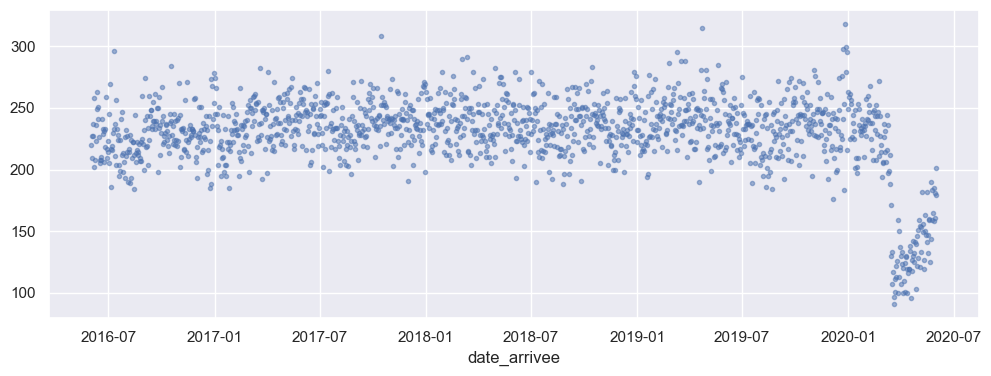

In [21]:
admissions_jour.plot(marker='.',alpha=0.5,linestyle='None')

Patients arrivé ce jour et qui vont rester +24h

In [22]:
admissions_jour_24h = df.groupby(df['date_arrivee'].dt.date)["duree_sejour"].apply(lambda x: x[x>pd.to_timedelta('1 days')].count())
admissions_jour_24h.head()

date_arrivee
2016-06-01    10
2016-06-02     8
2016-06-03    14
2016-06-04     6
2016-06-05    14
Name: duree_sejour, dtype: int64

<AxesSubplot:xlabel='date_arrivee'>

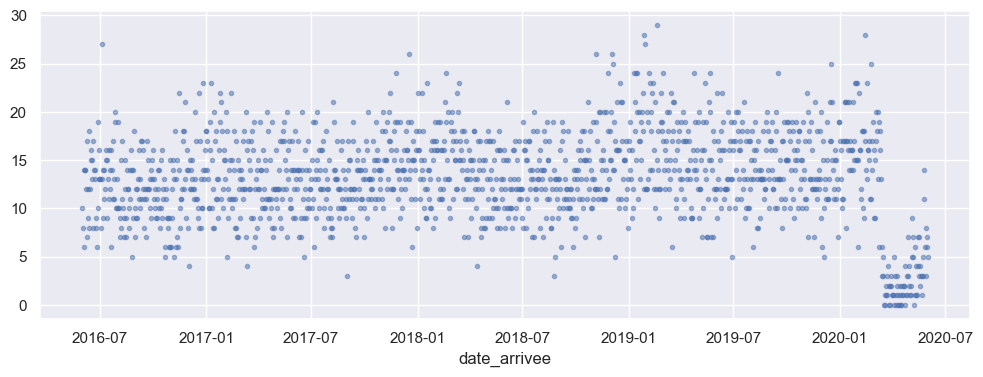

In [23]:
admissions_jour_24h.plot(marker='.',alpha=0.5,linestyle='None')

In [24]:
admissions_jour_10h = df.groupby(df['date_arrivee'].dt.date)["duree_sejour"].apply(lambda x: x[x>pd.to_timedelta('10 hours')].count())
admissions_jour_10h.head()

date_arrivee
2016-06-01    22
2016-06-02    31
2016-06-03    30
2016-06-04    20
2016-06-05    28
Name: duree_sejour, dtype: int64

In [25]:
admissions_jour_10h.index = pd.to_datetime(admissions_jour_10h.index)
admissions_jour_10h = admissions_jour_10h.to_frame("count")

In [26]:
adm_10h = pd.pivot_table(admissions_jour_10h,index=admissions_jour_10h.index.month,columns=admissions_jour_10h.index.day,
               values='count',aggfunc='mean')
index_month = ["Janvier", "Février","Mars","Avril","Mai","Juin","Juillet","Août","Septembre","Octobre","Novembre","Décembre"]
adm_10h.index = index_month

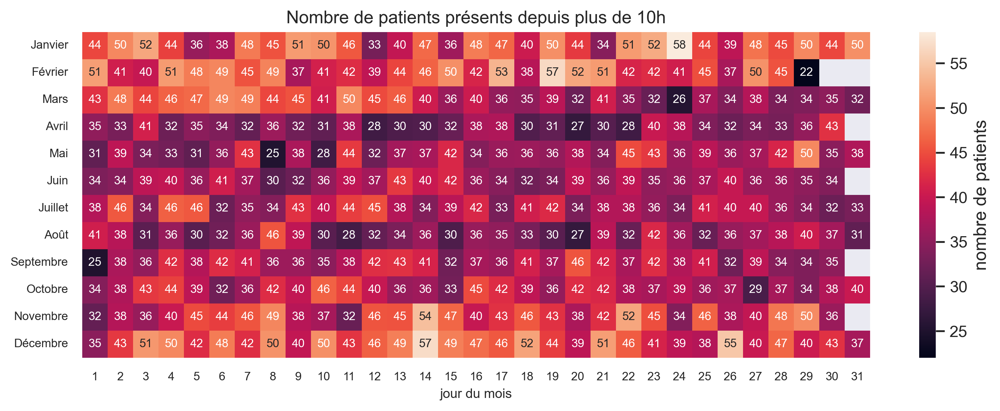

In [27]:
fig, axs = plt.subplots(dpi = 300) 

sns.heatmap(adm_10h, annot=True, annot_kws={"fontsize":8},fmt=".0f",xticklabels=True, ax=axs,cbar_kws={'label': 'nombre de patients'})
axs.set_title("Nombre de patients présents depuis plus de 10h",loc='center', fontsize=12)
axs.set_xlabel("jour du mois", fontsize = 9)
axs.tick_params(axis='both', which='major', labelsize=8)
    

In [28]:
fig.savefig(r'C:\Users\Tom\Desktop\Work Centrale\G2\IAS\Fil rouge\Cours_Filrouge_BDD\images\presence_10h.png', bbox_inches='tight')

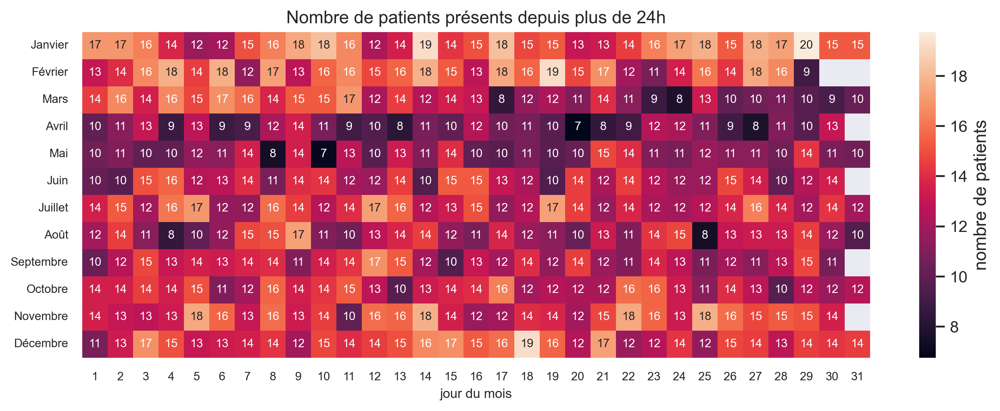

In [29]:
admissions_jour_24h = df.groupby(df['date_arrivee'].dt.date)["duree_sejour"].apply(lambda x: x[x>pd.to_timedelta('24 hours')].count())
admissions_jour_24h.head()

admissions_jour_24h.index = pd.to_datetime(admissions_jour_24h.index)
admissions_jour_24h = admissions_jour_24h.to_frame("count")

adm_24h = pd.pivot_table(admissions_jour_24h,index=admissions_jour_24h.index.month,columns=admissions_jour_24h.index.day,
               values='count',aggfunc='mean')
adm_24h.index = index_month
fig, axs = plt.subplots(dpi = 300) 

sns.heatmap(adm_24h, annot=True, annot_kws={"fontsize":8},fmt=".0f",xticklabels=True, ax=axs,cbar_kws={'label': 'nombre de patients'})
axs.set_title("Nombre de patients présents depuis plus de 24h",loc='center', fontsize=12)
axs.set_xlabel("jour du mois", fontsize = 9)
axs.tick_params(axis='both', which='major', labelsize=8)
    

In [32]:
fig.savefig(r'C:\Users\Tom\Desktop\Work Centrale\G2\IAS\Fil rouge\Cours_Filrouge_BDD\images\presence_24h.png', bbox_inches='tight')

<font color='RED'><font size='4'>PATIENTS PAR MOIS</font>


In [33]:
admissions_mois = df.groupby([(df.date_arrivee.dt.year), (df.date_arrivee.dt.month)]).count()["date_arrivee"]
admissions_mois = admissions_mois.rename("nb_admissions")

In [34]:
print(admissions_mois.idxmax())
print(admissions_mois.max(),"admissions")

(2019, 3)
7656 admissions


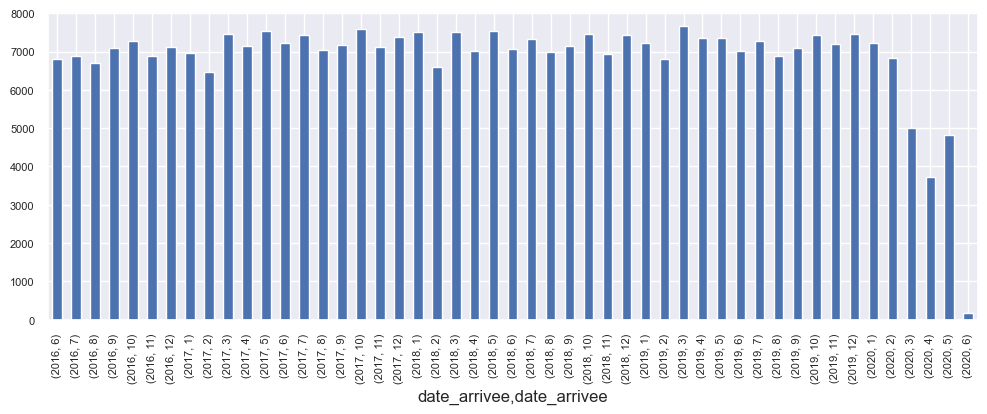

In [35]:
ax = admissions_mois.plot(kind='bar',fontsize=8)

In [36]:
fig = ax.get_figure()
fig.savefig('admissions_mois.png',bbox_inches='tight')

<font color='RED'><font size='4'>TEMPS DE PASSAGE PAR NIVEAU DE GRAVITE</font>


In [37]:
tps_ccmu = pd.pivot_table(df,index=df['ccmu'],
               values='duree_attente',aggfunc='mean')

In [38]:
tps_ccmu=tps_ccmu.squeeze()

In [39]:
tps_ccmu = tps_ccmu/datetime.timedelta(minutes=1)

Text(0.5, 1.0, "Temps d'attente par CCMU (minutes)")

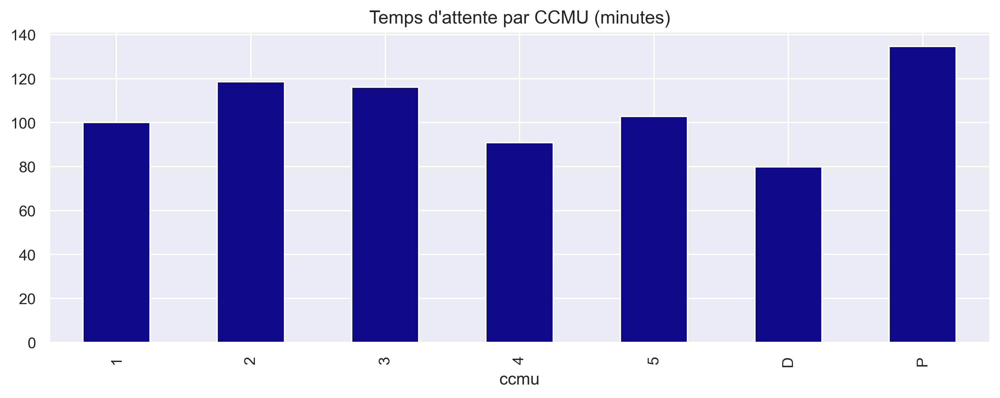

In [40]:
fig, ax = plt.subplots(dpi = 300) 
tps_ccmu.plot(kind='bar',colormap = 'plasma')
ax.set_title("Temps d'attente par CCMU (minutes)", fontsize=13)

In [41]:
fig.savefig('tps_ccmu.png',bbox_inches='tight')

In [42]:
tps_ccmu

ccmu
1     99.997849
2    118.597499
3    116.105855
4     90.830231
5    102.760049
D     79.857955
P    134.710488
Name: duree_attente, dtype: float64

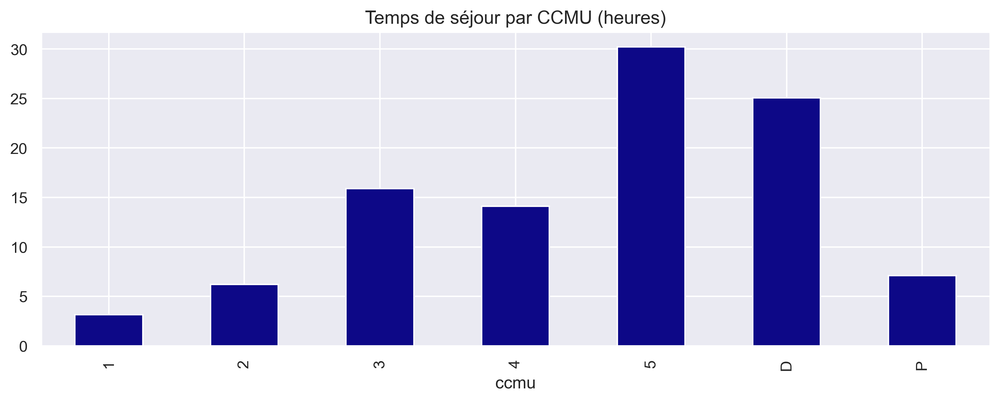

In [43]:
tps_ccmu = pd.pivot_table(df,index=df['ccmu'],
               values='duree_sejour',aggfunc='mean')

tps_ccmu=tps_ccmu.squeeze()

tps_ccmu = tps_ccmu/datetime.timedelta(hours=1)

fig, ax = plt.subplots(dpi = 300) 
tps_ccmu.plot(kind='bar',colormap = 'plasma')
ax.set_title("Temps de séjour par CCMU (heures)", fontsize=13)

fig.savefig('tps_ccmu_tot.png',bbox_inches='tight')

<font color='RED'><font size='4'>NOMBRE DE PATIENTS AYANT EU RECOURS A UN EXAM COMPLEMENTAIRE</font>


In [44]:
nb_exam_compl = pd.pivot_table(df,index=df.nb_exam,values='nb_exam',aggfunc='count')/df.shape[0]
nb_exam_compl=nb_exam_compl.squeeze()

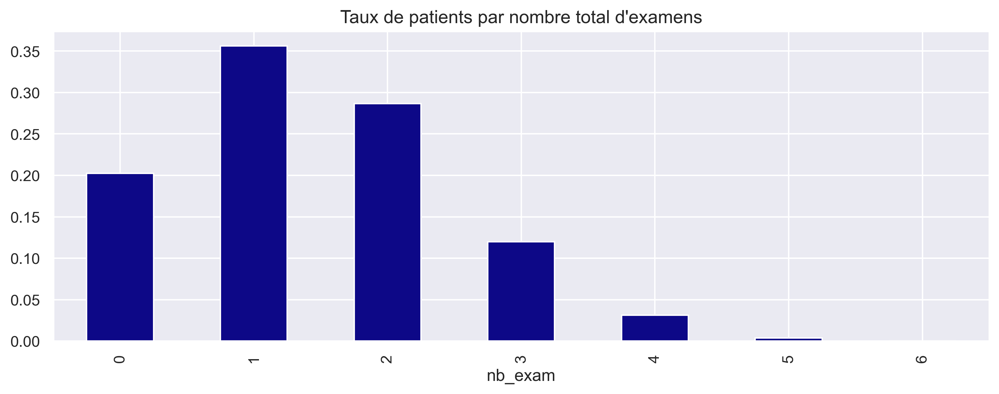

In [45]:
fig, ax = plt.subplots(dpi = 300) 
nb_exam_compl.plot(kind='bar', colormap ='plasma')
ax.set_title("Taux de patients par nombre total d'examens", fontsize=13)
fig.savefig('tx_compl_nb_exam.png',bbox_inches='tight')

In [219]:
admissions_jour_compl = df.groupby(df['date_arrivee'].dt.date)["nb_exam"].apply(lambda x: x[x>1].count())/(df.groupby(df['date_arrivee'].dt.date).size())

admissions_jour_compl.head()

date_arrivee
2016-06-01    0.495455
2016-06-02    0.449761
2016-06-03    0.418502
2016-06-04    0.438819
2016-06-05    0.378855
dtype: float64

In [209]:
from sklearn import datasets, linear_model

In [220]:
admissions_jour_compl =admissions_jour_compl.to_frame()

In [227]:
admissions_jour_compl=admissions_jour_compl.rename(columns={0:"taux"})

date_arrivee
2016-06-01    0.495455
2016-06-02    0.449761
2016-06-03    0.418502
2016-06-04    0.438819
2016-06-05    0.378855
                ...   
2020-05-28    0.535135
2020-05-29    0.563536
2020-05-30    0.559006
2020-05-31    0.497512
2020-06-01    0.463687
Name: taux, Length: 1462, dtype: float64

In [236]:
regr = linear_model.LinearRegression()
length= len(admissions_jour_compl.index)
x = np.array(range(length))
y = np.array(admissions_jour_compl.taux)

x = x.reshape(length, 1)
y = y.reshape(length, 1)
regr.fit(x, y)

LinearRegression()

In [241]:
regr.predict(x)

array([[0.45244296],
       [0.45242947],
       [0.45241597],
       ...,
       [0.43275165],
       [0.43273815],
       [0.43272465]])

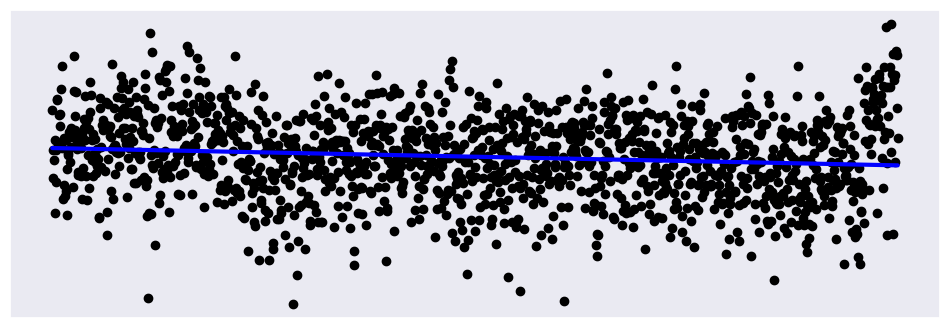

In [237]:
plt.scatter(x, y,  color='black')
plt.plot(x, regr.predict(x), color='blue', linewidth=3)
plt.xticks(())
plt.yticks(())
plt.show()

In [245]:
admissions_jour_compl["pred"]=regr.predict(x)

In [250]:
admissions_jour_compl.shape

(1462, 2)

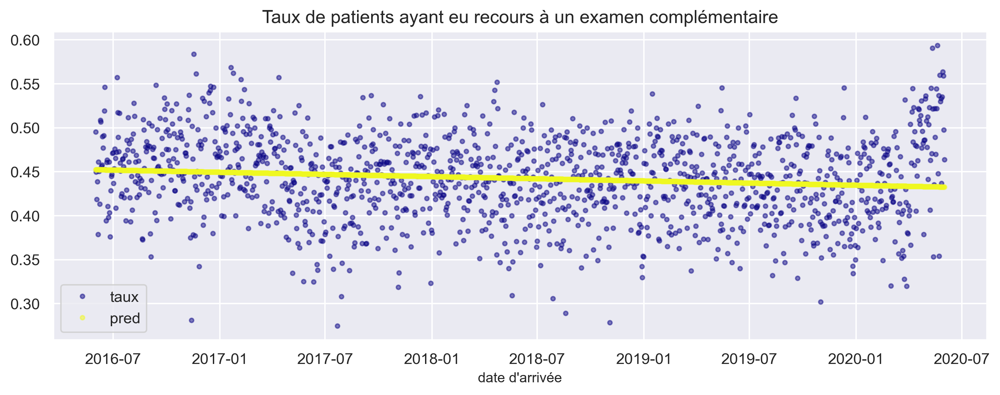

In [261]:
fig, ax = plt.subplots(dpi = 300, nrows =1) 
#admissions_jour_compl.plot(marker='.',alpha=0.5,linestyle='None', colormap='plasma')
admissions_jour_compl.plot(marker='.',alpha=0.5,linestyle='None', colormap='plasma',ax=ax)

ax.set_title("Taux de patients ayant eu recours à un examen complémentaire", fontsize=13)
ax.set_xlabel("date d'arrivée",fontsize=10)

fig.savefig('tx_exam_compl.png',bbox_inches='tight')

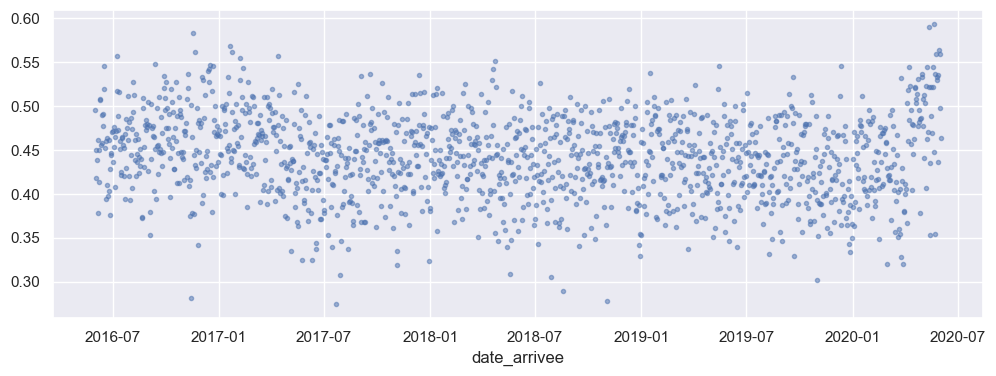

In [48]:
a_compl = admissions_jour_compl.plot(marker='.',alpha=0.5,linestyle='None')

In [49]:
print(admissions_jour_compl.idxmin(), admissions_jour_compl.min())


2017-07-22 0.2748091603053435


In [50]:
df[df["date_arrivee"].dt.date==datetime.date(2017, 11, 19)]

,date_arrivee,moyen_arrivee,motif_entree,motif_venue,age,antecedents_medicaux,antecedents_chirurgicaux,pas_pad,fc,temperature,...,or_destination,or_trsfert_service,or_trsfert_hop,code_postal,ville,duree_sejour,duree_attente,duree_traitement,count,nb_exam
125057,2017-11-19 00:02:00,MOYENS PERSONNELS,douleur abdo depuis 19h,Gastro-entérologie: Douleur abdominale non épi...,23,NaN,NaN,144/92,83,"37,3",...,RETOUR DOMICILE,NaN,NaN,59000,LILLE,0 days 05:45:00,0 days 01:18:00,0 days 04:27:00,1,1
125058,2017-11-19 00:05:00,MOYENS PERSONNELS,douleur abdo vu pas SOS tumefaction FIG,Gastro-entérologie: Douleur abdominale non épi...,23,NaN,NaN,113/66,88,"36,4",...,RETOUR DOMICILE,NaN,NaN,59000,LILLE,0 days 04:33:00,0 days 04:21:00,0 days 00:12:00,1,1
125059,2017-11-19 00:07:00,AMBULANCE PRIVEE,plaie arcade droite,Traumatologie: Plaie superficielle,21,NaN,NaN,43994,105,"36,2",...,RETOUR DOMICILE,NaN,NaN,59130,LAMBERSART,0 days 01:22:00,0 days 01:17:00,0 days 00:05:00,1,0
125060,2017-11-19 00:24:00,MOYENS PERSONNELS,chute de 2 m reception sur le dos,Traumatologie: Traumatisme (patient non valide),42,NaN,NaN,100/66,90,"36,5",...,RETOUR DOMICILE,NaN,NaN,59112,ANNOEULLIN,0 days 02:00:00,0 days 01:50:00,0 days 00:10:00,1,1
125061,2017-11-19 00:45:00,MOYENS PERSONNELS,douleur tho,Cardiologie: Douleur thoracique atypique,33,NaN,Appendicectomie,151/93,106,"36,6",...,RETOUR DOMICILE,NaN,NaN,59940,ESTAIRES,0 days 04:58:00,0 days 00:30:00,0 days 04:28:00,1,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
125280,2017-11-19 22:57:00,AMBULANCE PRIVEE,"Dlrs FIGauche, Stat inf neg",Gastro-entérologie: Douleur abdominale (patien...,26,NaN,NaN,123/69,70,36,...,RETOUR DOMICILE,NaN,NaN,59120,LOOS,0 days 08:47:00,0 days 01:00:00,0 days 07:47:00,1,1
125281,2017-11-19 23:07:00,MOYENS PERSONNELS,Susp abcès marge anale?,"Gastro-entérologie: Proctologie (abcès, fissur...",35,NaN,NaN,142/108,135,"36,3",...,RETOUR DOMICILE Consultation externe le/dans 2...,NaN,NaN,59160,LILLE,0 days 02:17:00,0 days 01:13:00,0 days 01:04:00,1,0
125282,2017-11-19 23:27:00,AMBULANCE PRIVEE,"hernie hiatale depuis 10 ans, ce soir dlrs ++ ...","Gastro-entérologie: Nausées, vomissements Doul...",32,"hernie hiatale, oesophagite grade 1 à la FOGD ...",RAS,155/93,53,37,...,PARTIE SANS ATTENDRE,NaN,NaN,59000,LILLE,0 days 02:51:00,0 days 01:12:00,0 days 01:39:00,1,1
125283,2017-11-19 23:30:00,MOYENS PERSONNELS,"Dlrs abdo avec vomissement, Stat inf neg","Gastro-entérologie: Nausées, vomissements Doul...",26,NaN,NaN,128/74,101,"36,8",...,RETOUR DOMICILE,NaN,NaN,59510,HEM,0 days 05:57:00,0 days 00:40:00,0 days 05:17:00,1,1


<font color='RED'><font size='4'>NOMBRE DE PATIENTS SUR 3J</font>


In [51]:
admissions_3j = df.groupby(df['date_arrivee'].dt.date).size()
print(admissions_3j)

date_arrivee
2016-06-01    220
2016-06-02    209
2016-06-03    227
2016-06-04    237
2016-06-05    227
             ... 
2020-05-28    185
2020-05-29    181
2020-05-30    161
2020-05-31    201
2020-06-01    179
Length: 1462, dtype: int64


In [52]:
admissions_3j.index = pd.to_datetime(admissions_3j.index,dayfirst=True,errors='coerce')
admissions_3j = admissions_3j.resample(pd.to_timedelta('3 days'),label='right').sum()

In [53]:
admissions_3j.head()

date_arrivee
2016-06-04    656
2016-06-07    722
2016-06-10    646
2016-06-13    735
2016-06-16    718
Freq: 3D, dtype: int64

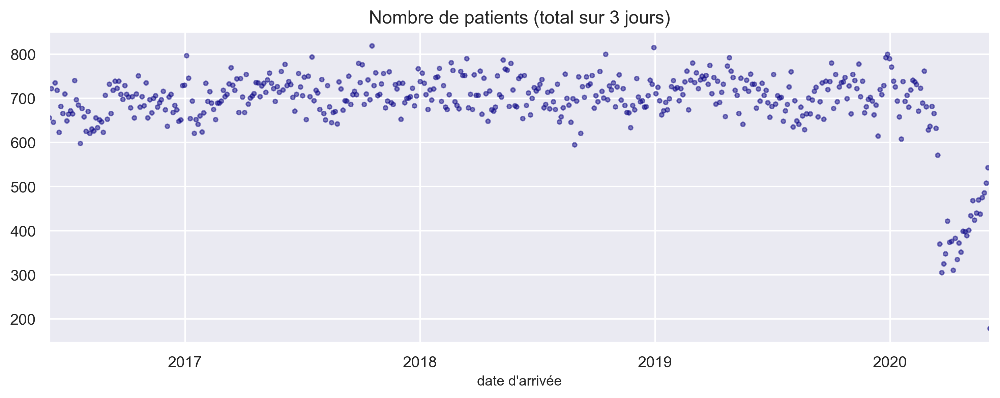

In [54]:
fig, ax = plt.subplots(dpi = 300) 
admissions_3j.plot(marker='.',alpha=0.5,linestyle='None', colormap='plasma')
ax.set_title("Nombre de patients (total sur 3 jours)", fontsize=13)
ax.set_xlabel("date d'arrivée",fontsize=10)
fig.savefig('arr_3j.png',bbox_inches='tight')

<font color='RED'><font size='4'>DUREE D'ATTENTE DEPUIS 2H </font>


In [55]:
attente_2h = df[df["duree_attente"]>pd.to_timedelta('2 hours')].groupby([df['date_arrivee'].dt.date,df['date_arrivee'].dt.hour]).size()
attente_2h.head()

date_arrivee  date_arrivee
2016-06-01    9               1
              10              1
              11              3
              12              2
              13              3
dtype: int64

In [56]:
attente_2h = df[df["duree_attente"]>pd.to_timedelta('2 hours')]
attente_2h = attente_2h.filter(["date_arrivee", "duree_attente"])

In [57]:
attente_2h.index = attente_2h.date_arrivee

In [58]:
attente_2h = attente_2h.resample(pd.to_timedelta('2 hours'),label='right').mean()
attente_2h = attente_2h.drop("date_arrivee",axis=1)
attente_2h = attente_2h/datetime.timedelta(minutes=1)

In [59]:
df.duree_attente.idxmax()

97842

In [60]:
df.iloc[df.duree_attente.idxmax()-1]

date_arrivee                                              2017-07-27 09:00:00
moyen_arrivee                                              AMB PUBLIQUE CHRU 
motif_entree                                                              NaN
motif_venue                                                               NaN
age                                                                        72
antecedents_medicaux                                                      NaN
antecedents_chirurgicaux                                                  NaN
pas_pad                                                                   NaN
fc                                                                        NaN
temperature                                                               NaN
sao2                                                                      NaN
fr                                                                        NaN
ccmu                                                            

In [61]:
attente_2h.head()

,duree_attente
date_arrivee,
2016-06-01 10:00:00,131.000000
2016-06-01 12:00:00,183.750000
2016-06-01 14:00:00,150.800000
2016-06-01 16:00:00,212.363636
2016-06-01 18:00:00,159.500000


In [62]:
attente_2h=attente_2h[attente_2h.duree_attente<600].squeeze()

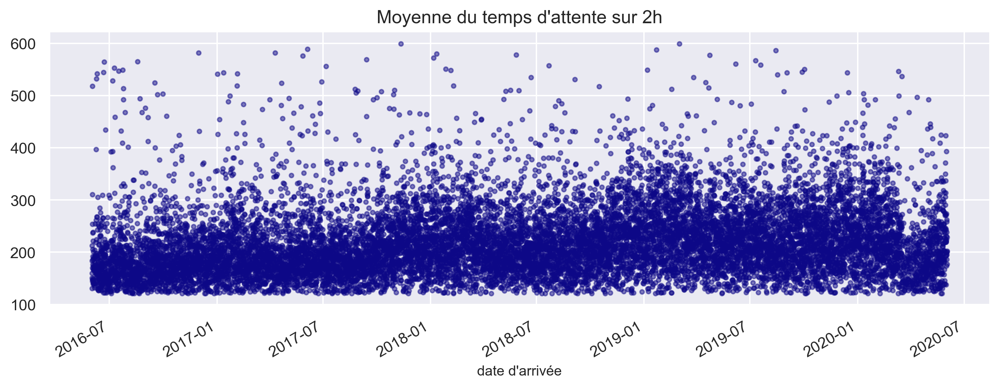

In [63]:
fig, ax = plt.subplots(dpi = 300) 
attente_2h.plot(marker='.',alpha=0.5,linestyle='None', colormap='plasma')
ax.set_title("Moyenne du temps d'attente sur 2h", fontsize=13)
ax.set_xlabel("date d'arrivée",fontsize=10)
fig.savefig('attente_2h',bbox_inches='tight')

In [64]:
attente_2h_sample = attente_2h.loc[datetime.date(year=2016,month=6,day=1):datetime.date(year=2016,month=6,day=15)].squeeze()


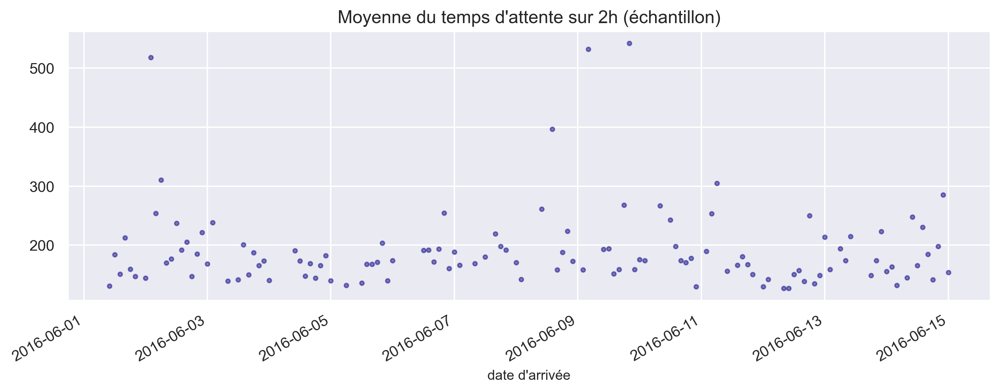

In [65]:
fig, ax = plt.subplots(dpi = 300) 
attente_2h_sample.plot(marker='.',alpha=0.5,linestyle='None', colormap='plasma')
ax.set_title("Moyenne du temps d'attente sur 2h (échantillon)", fontsize=13)
ax.set_xlabel("date d'arrivée",fontsize=10)
fig.savefig('attente_2h_sample',bbox_inches='tight')


<font color='RED'><font size='4'>ANALYSE SAISONNIERE </font>


<font color='GREEN'><font size='3'>FREQUENTATION HEBDOMADAIRE </font>


In [66]:
count_in_dh = df.groupby('date_arrivee')['date_arrivee'].count()

In [67]:
count_in_dh = count_in_dh.to_frame("count")

In [68]:
count_in_dh = count_in_dh.resample("H").sum()

In [69]:
day_hour_in = pd.pivot_table(count_in_dh,index=count_in_dh.index.dayofweek,columns=count_in_dh.index.hour,
               values='count',aggfunc='mean')

In [70]:
index_dh = ["Lundi","Mardi","Mercredi","Jeudi","Vendredi","Samedi","Dimanche"]

In [71]:
day_hour_in.index = index_dh

<AxesSubplot:xlabel='date_arrivee'>

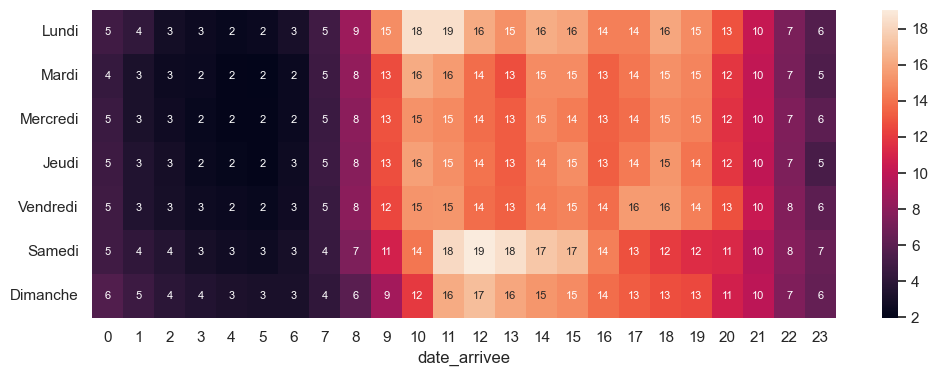

In [72]:
sns.heatmap(day_hour_in,annot=True, annot_kws={"fontsize":8},fmt=".0f")

<font color='GREEN'><font size='3'>ATTENTE HEBDOMADAIRE </font>


In [73]:
df_t = df.copy()
df_t["duree_attente"] = df_t.duree_attente/datetime.timedelta(hours=1)
df_t["duree_sejour"] = df_t.duree_sejour/datetime.timedelta(hours=1)
df_t["duree_traitement"] = df_t.duree_traitement/datetime.timedelta(hours=1)
df_t = df_t[df_t.duree_attente < 12]
df_t = df_t[df_t.duree_sejour < 168]
df_t= df_t[df_t.duree_traitement >0]



In [74]:
day_hour_w = pd.pivot_table(df_t,index=df_t['date_arrivee'].dt.dayofweek,columns=df_t['date_arrivee'].dt.hour,
               values='duree_attente',aggfunc='mean')

In [75]:
day_hour_w.index = index_dh

On convertit l'attente en heures

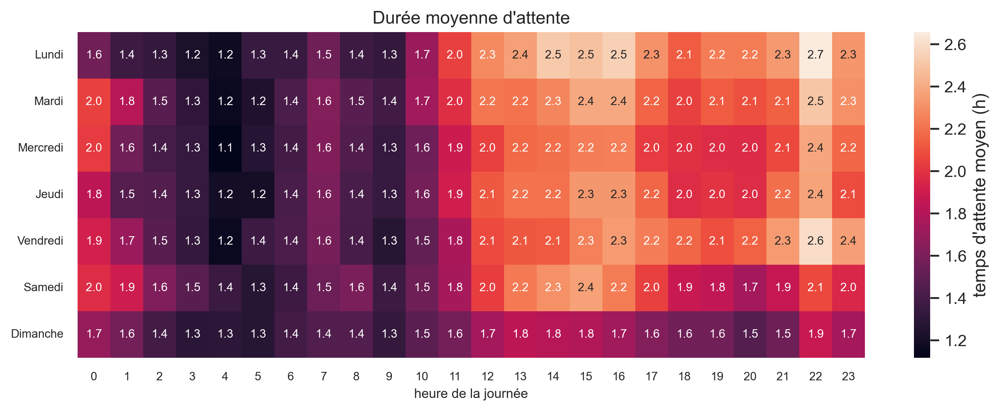

In [76]:
fig, axs = plt.subplots(dpi = 300) 

sns.heatmap(day_hour_w,annot=True, annot_kws={"fontsize":8},fmt=".1f",xticklabels=True, ax=axs,cbar_kws={'label': "temps d'attente moyen (h)"})
axs.set_title("Durée moyenne d'attente",loc='center', fontsize=12)
axs.set_xlabel("heure de la journée", fontsize = 9)
axs.tick_params(axis='both', which='major', labelsize=8)
fig.savefig(r'C:\Users\Tom\Desktop\Work Centrale\G2\IAS\Fil rouge\Cours_Filrouge_BDD\images\attente_hebdo.png', bbox_inches='tight')

In [77]:
month_w = pd.pivot_table(df_t,index=df_t['date_arrivee'].dt.month,columns=df_t['date_arrivee'].dt.day,
               values='duree_attente',aggfunc='mean')
month_w.index = index_month


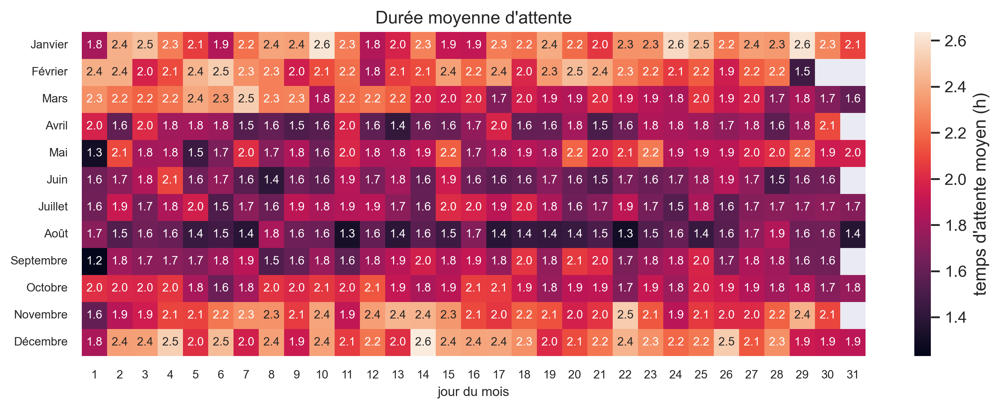

In [78]:
fig, axs = plt.subplots(dpi = 300) 

sns.heatmap(month_w,annot=True, annot_kws={"fontsize":8},fmt=".1f",xticklabels=True, ax=axs,cbar_kws={'label': "temps d'attente moyen (h)"})
axs.set_title("Durée moyenne d'attente",loc='center', fontsize=12)
axs.set_xlabel("jour du mois", fontsize = 9)
axs.tick_params(axis='both', which='major', labelsize=8)
fig.savefig(r'C:\Users\Tom\Desktop\Work Centrale\G2\IAS\Fil rouge\Cours_Filrouge_BDD\images\attente_mois.png', bbox_inches='tight')

Duree séjour

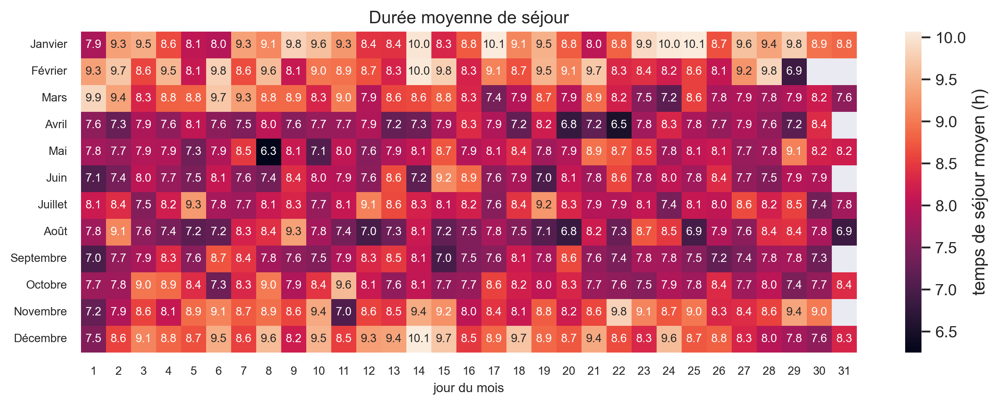

In [79]:
month_sej = pd.pivot_table(df_t,index=df_t['date_arrivee'].dt.month,columns=df_t['date_arrivee'].dt.day,
               values='duree_sejour',aggfunc='mean')
month_sej.index = index_month

fig, axs = plt.subplots(dpi = 300) 

sns.heatmap(month_sej,annot=True, annot_kws={"fontsize":8},fmt=".1f",xticklabels=True, ax=axs,cbar_kws={'label': "temps de séjour moyen (h)"})
axs.set_title("Durée moyenne de séjour",loc='center', fontsize=12)
axs.set_xlabel("jour du mois", fontsize = 9)
axs.tick_params(axis='both', which='major', labelsize=8)
fig.savefig(r'C:\Users\Tom\Desktop\Work Centrale\G2\IAS\Fil rouge\Cours_Filrouge_BDD\images\sejour_mois.png', bbox_inches='tight')

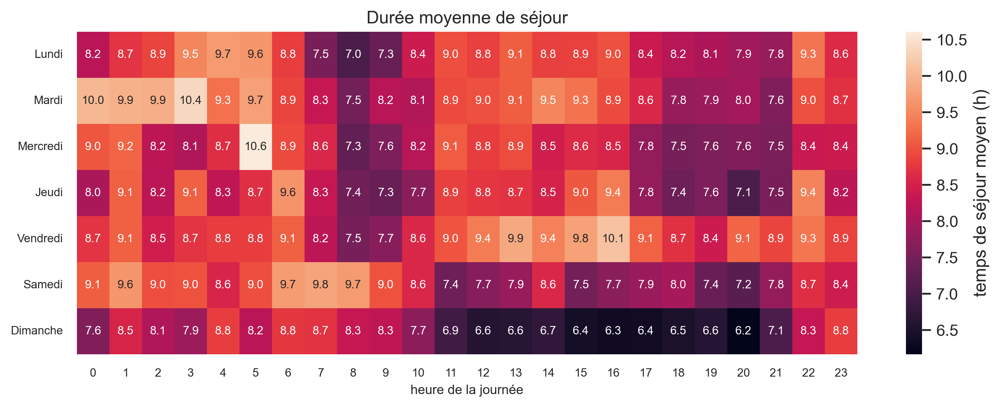

In [80]:
dh_sej = pd.pivot_table(df_t,index=df_t['date_arrivee'].dt.dayofweek,columns=df_t['date_arrivee'].dt.hour,
               values='duree_sejour',aggfunc='mean')
dh_sej.index = index_dh

fig, axs = plt.subplots(dpi = 300) 

sns.heatmap(dh_sej,annot=True, annot_kws={"fontsize":8},fmt=".1f",xticklabels=True, ax=axs,cbar_kws={'label': "temps de séjour moyen (h)"})
axs.set_title("Durée moyenne de séjour",loc='center', fontsize=12)
axs.set_xlabel("heure de la journée", fontsize = 9)
axs.tick_params(axis='both', which='major', labelsize=8)
fig.savefig(r'C:\Users\Tom\Desktop\Work Centrale\G2\IAS\Fil rouge\Cours_Filrouge_BDD\images\sejour_dh.png', bbox_inches='tight')

duree_traitement

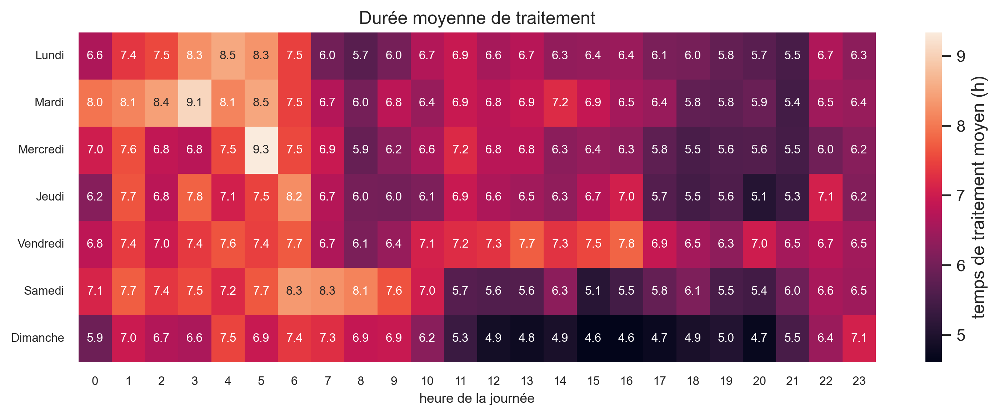

In [81]:
dh_trt = pd.pivot_table(df_t,index=df_t['date_arrivee'].dt.dayofweek,columns=df_t['date_arrivee'].dt.hour,
               values='duree_traitement',aggfunc='mean')
dh_trt.index = index_dh

fig, axs = plt.subplots(dpi = 300) 

sns.heatmap(dh_trt,annot=True, annot_kws={"fontsize":8},fmt=".1f",xticklabels=True, ax=axs,cbar_kws={'label': "temps de traitement moyen (h)"})
axs.set_title("Durée moyenne de traitement",loc='center', fontsize=12)
axs.set_xlabel("heure de la journée", fontsize = 9)
axs.tick_params(axis='both', which='major', labelsize=8)
fig.savefig(r'C:\Users\Tom\Desktop\Work Centrale\G2\IAS\Fil rouge\Cours_Filrouge_BDD\images\trt_dh.png', bbox_inches='tight')

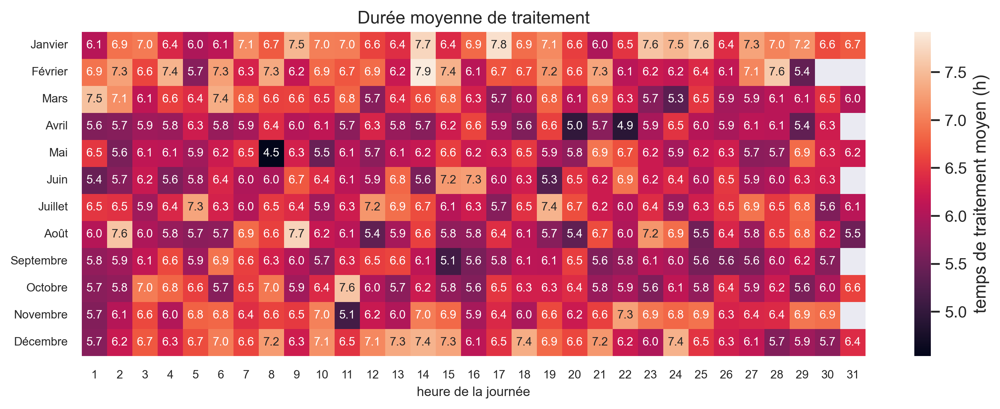

In [82]:
dh_trt = pd.pivot_table(df_t,index=df_t['date_arrivee'].dt.month,columns=df_t['date_arrivee'].dt.day,
               values='duree_traitement',aggfunc='mean')
dh_trt.index = index_month

fig, axs = plt.subplots(dpi = 300) 

sns.heatmap(dh_trt,annot=True, annot_kws={"fontsize":8},fmt=".1f",xticklabels=True, ax=axs,cbar_kws={'label': "temps de traitement moyen (h)"})
axs.set_title("Durée moyenne de traitement",loc='center', fontsize=12)
axs.set_xlabel("heure de la journée", fontsize = 9)
axs.tick_params(axis='both', which='major', labelsize=8)
fig.savefig(r'C:\Users\Tom\Desktop\Work Centrale\G2\IAS\Fil rouge\Cours_Filrouge_BDD\images\trt_month.png', bbox_inches='tight')

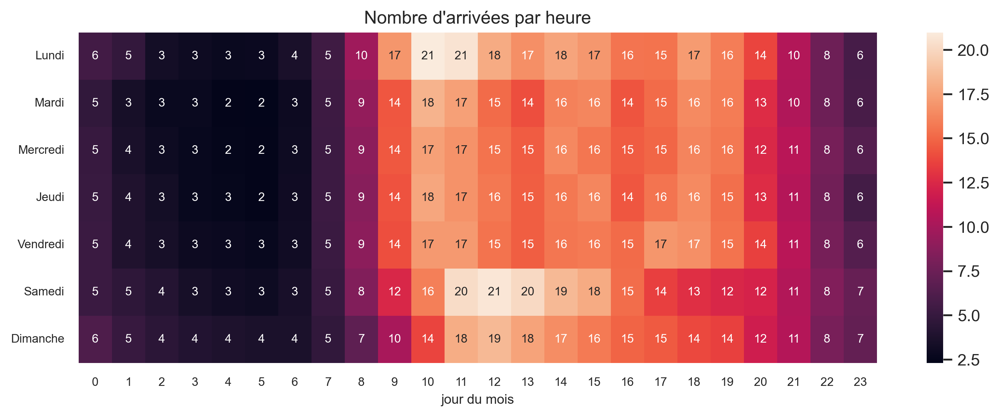

In [83]:
arr_dh = pd.pivot_table(df_t,index=df_t['date_arrivee'].dt.dayofweek,columns=df_t['date_arrivee'].dt.hour,
               values='count',aggfunc='count')/168
arr_dh.index = index_dh

fig, axs = plt.subplots(dpi = 300) 

sns.heatmap(arr_dh,annot=True, annot_kws={"fontsize":8},fmt=".0f",xticklabels=True, ax=axs)
axs.set_title("Nombre d'arrivées par heure",loc='center', fontsize=12)
axs.set_xlabel("jour du mois", fontsize = 9)
axs.tick_params(axis='both', which='major', labelsize=8)
fig.savefig(r'C:\Users\Tom\Desktop\Work Centrale\G2\IAS\Fil rouge\Cours_Filrouge_BDD\images\arr_dh.png', bbox_inches='tight')

<font color='RED'><font size='5'>NOMBRE DE PERSONNES PAR HEURE (en moyenne), TENSION</font>


<font color='green'><font size='3'>calcul du nb de personnes aux urgences par heure, TENSION</font>


Nombres de lignes non vides pour chaque colonne

In [84]:
df.count()



date_arrivee                336253
moyen_arrivee               334907
motif_entree                311802
motif_venue                 307534
age                         336253
antecedents_medicaux        102623
antecedents_chirurgicaux     71134
pas_pad                     242618
fc                          244278
temperature                 267414
sao2                        225761
fr                           10785
ccmu                        293122
salles                      336253
entree_box                  186938
anamnese                    178028
observation                  28559
exam_biologie               336253
exam_radiologie             336253
exam_radiographie           336253
exam_scanner                336253
exam_irm                    336253
exam_avis_specialiste       336253
date_presc_bio              167448
date_bio                    164481
code_diag                   279595
diag_texte                  279595
cac_admission               336243
cac_sejour          

On dirait qu'il y a quelque valeurs nulles de duree_sejour, comment les trouver ?

In [85]:
count_in = df.groupby('date_arrivee')['date_arrivee'].count()
count_out = df.groupby('date_sortie')['date_sortie'].count()
count_data = pd.concat([count_in, count_out], axis=1).fillna(0).cumsum()
df2 = count_data['date_arrivee'] - count_data['date_sortie']

In [86]:
df2.describe()

count    561795.000000
mean         85.451750
std          20.864627
min           0.000000
25%          71.000000
50%          86.000000
75%         100.000000
max         154.000000
dtype: float64

In [87]:
df2.head()

2016-06-01 00:16:00    1.0
2016-06-01 00:18:00    2.0
2016-06-01 00:36:00    3.0
2016-06-01 00:43:00    4.0
2016-06-01 01:16:00    5.0
dtype: float64

In [88]:
df3 = df2.resample("1H").mean()

In [89]:
df3.head()

2016-06-01 00:00:00     2.500000
2016-06-01 01:00:00     7.000000
2016-06-01 02:00:00    11.000000
2016-06-01 03:00:00    11.333333
2016-06-01 04:00:00    10.444444
Freq: H, dtype: float64

In [90]:
df3.describe()

count    35055.000000
mean        78.025244
std         22.284675
min          0.000000
25%         61.724747
50%         77.600000
75%         93.800000
max        150.370370
dtype: float64

In [91]:
debut = "2016-06-01"
fin = "2016-10-01"


df4 = df3[(df3.index > '2018-7-1') & (df3.index <= '2018-8-1')]

In [92]:
df4.size

744

In [93]:
df4 = df4.resample("24H").mean()

<AxesSubplot:>

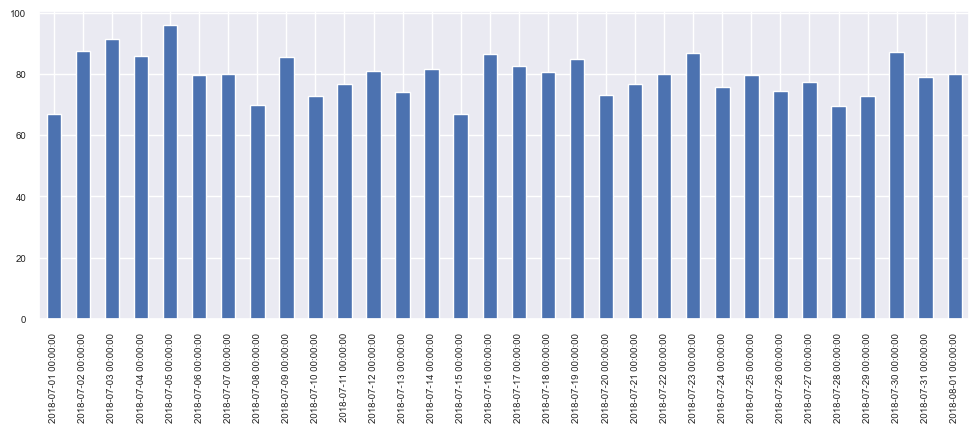

In [94]:
df4.plot(kind='bar',fontsize=7)

<font color='RED'><font size='4'>Saisonnalité de la tension, moyenne du nombre de patients dans le service</font>


In [95]:
df5 = df2.to_frame("nb_patients")

In [96]:
df5.head()

,nb_patients
2016-06-01 00:16:00,1.0
2016-06-01 00:18:00,2.0
2016-06-01 00:36:00,3.0
2016-06-01 00:43:00,4.0
2016-06-01 01:16:00,5.0


In [97]:
tension_day_hour = pd.pivot_table(df5,index=df5.index.dayofweek,columns=df5.index.hour,
               values='nb_patients',aggfunc='mean')
tension_day_hour.index = index_dh

<font color='green'><font size='3'>A noter, on fait la MOYENNE de la présence sur une heure,on pourrait aussi prendre le max pour voir la tension !</font>


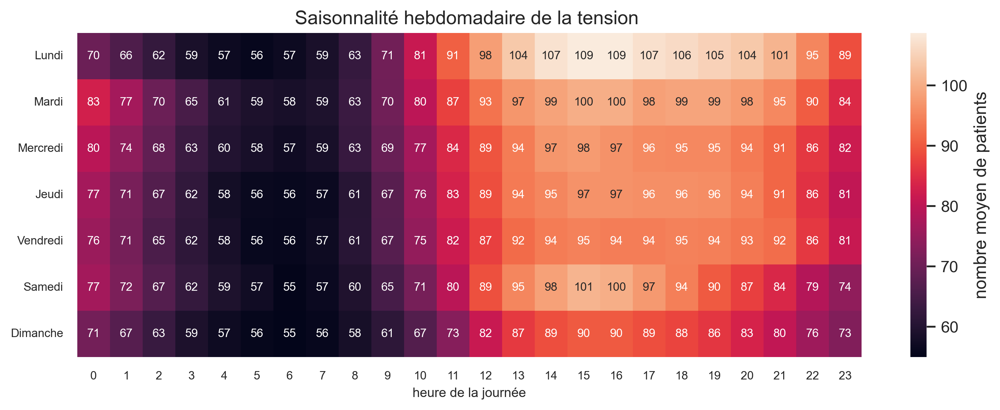

In [98]:
fig, axs = plt.subplots(dpi = 300) 

sns.heatmap(tension_day_hour, annot=True, annot_kws={"fontsize":8},fmt=".0f",xticklabels=True, ax=axs,cbar_kws={'label': 'nombre moyen de patients'})
axs.set_title("Saisonnalité hebdomadaire de la tension ",loc='center', fontsize=13)
axs.set_xlabel("heure de la journée", fontsize = 9)
axs.tick_params(axis='both', which='major', labelsize=8)
    

In [99]:
fig.savefig(r'C:\Users\Tom\Desktop\Work Centrale\G2\IAS\Fil rouge\Cours_Filrouge_BDD\images\tension_hebdo.png', bbox_inches='tight')

In [100]:
df6 = df5
season = (df6.index.month - 1) // 3
season += (df6.index.month == 3)&(df6.index.day>=20)
season += (df6.index.month == 6)&(df6.index.day>=21)
season += (df6.index.month == 9)&(df6.index.day>=23)
season -= 3*((df6.index.month == 12)&(df6.index.day>=21)).astype(int)

In [101]:
df6['season'] = season

In [102]:
df6.head()

,nb_patients,season
2016-06-01 00:16:00,1.0,1
2016-06-01 00:18:00,2.0,1
2016-06-01 00:36:00,3.0,1
2016-06-01 00:43:00,4.0,1
2016-06-01 01:16:00,5.0,1


In [103]:
tension_saison2 = pd.pivot_table(df6,index=df6.season,
               values='nb_patients',aggfunc='mean')
index_saison = ["Hiver","Printemps","Eté","Automne"]
tension_saison2.index = index_saison


In [104]:
my_series = tension_saison2.squeeze()

<AxesSubplot:>

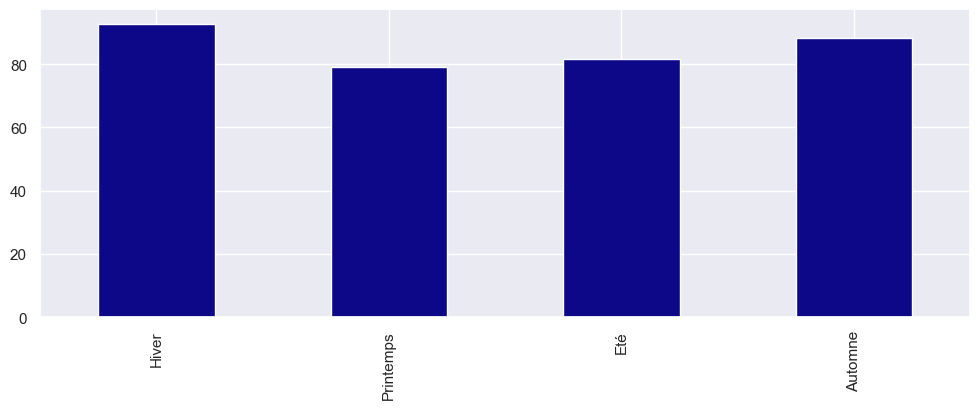

In [105]:
my_series.plot(kind='bar',colormap='plasma')

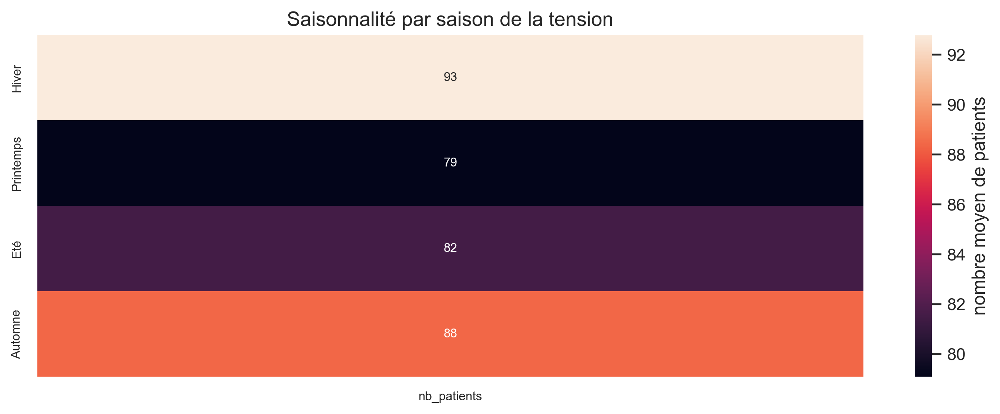

In [106]:
fig, axs = plt.subplots(dpi = 300) 

sns.heatmap(tension_saison2, annot=True, annot_kws={"fontsize":8},fmt=".0f",xticklabels=True, ax=axs,cbar_kws={'label': 'nombre moyen de patients'})
axs.set_title("Saisonnalité par saison de la tension",loc='center', fontsize=13)
axs.tick_params(axis='both', which='major', labelsize=8)
    

In [107]:
fig.savefig(r'C:\Users\Tom\Desktop\Work Centrale\G2\IAS\Fil rouge\Cours_Filrouge_BDD\images\tension_moy_saison.png', bbox_inches='tight')

In [108]:
tension_saison = pd.pivot_table(df6,index=df6.season,columns=df5.index.day,
               values='nb_patients',aggfunc='mean')
index_saison = ["Hiver","Printemps","Eté","Automne"]
tension_saison.index = index_saison


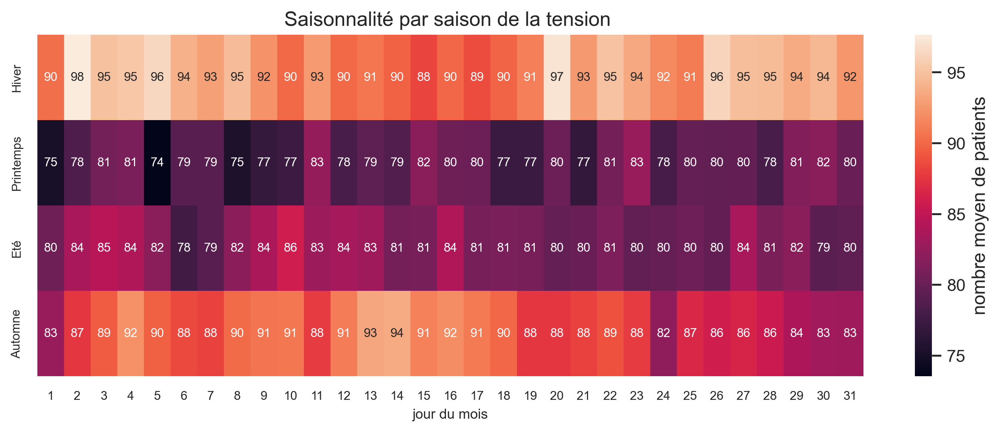

In [109]:
fig, axs = plt.subplots(dpi = 300) 

sns.heatmap(tension_saison, annot=True, annot_kws={"fontsize":8},fmt=".0f",xticklabels=True, ax=axs,cbar_kws={'label': 'nombre moyen de patients'})
axs.set_title("Saisonnalité par saison de la tension ",loc='center', fontsize=13)
axs.set_xlabel("jour du mois", fontsize = 9)
axs.tick_params(axis='both', which='major', labelsize=8)
    

In [110]:
fig.savefig(r'C:\Users\Tom\Desktop\Work Centrale\G2\IAS\Fil rouge\Cours_Filrouge_BDD\images\tension_saison.png', bbox_inches='tight')

In [111]:
tension_month = pd.pivot_table(df5,index=df5.index.month,columns=df5.index.day,
               values='nb_patients',aggfunc='mean')
tension_month.index = index_month


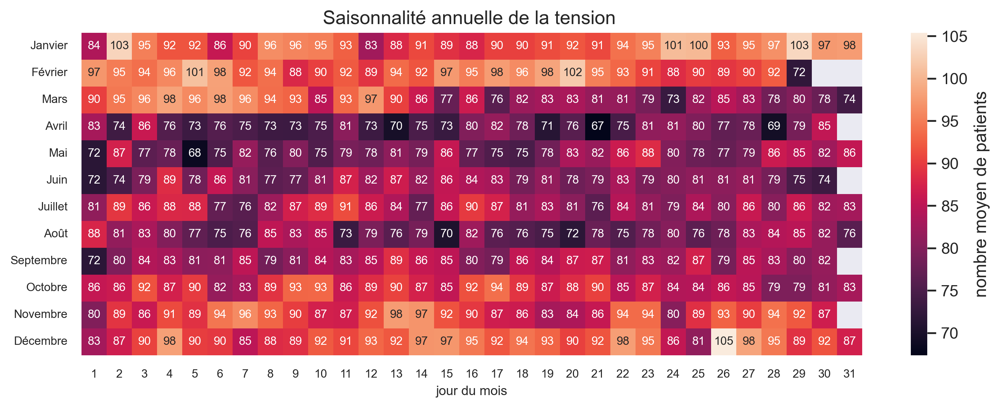

In [112]:
fig, axs = plt.subplots(dpi = 300) 

sns.heatmap(tension_month, annot=True, annot_kws={"fontsize":8},fmt=".0f",xticklabels=True, ax=axs,cbar_kws={'label': 'nombre moyen de patients'})
axs.set_title("Saisonnalité annuelle de la tension ",loc='center', fontsize=13)
axs.set_xlabel("jour du mois", fontsize = 9)
axs.tick_params(axis='both', which='major', labelsize=8)
    

In [113]:
fig.savefig(r'C:\Users\Tom\Desktop\Work Centrale\G2\IAS\Fil rouge\Cours_Filrouge_BDD\images\tension_annuelle.png', bbox_inches='tight')

<font color='RED'><font size='4'>Saisonnalité de la tension, moyenne du nombre de patients EN ATTENTE dans le service</font>


On drop les lignes où il n'y a pas de date de prise en charge AVEC pd.notnull ... environ 25k

In [114]:
count_in_wait = df[pd.notnull(df['date_prise_charge'])].groupby('date_arrivee')['date_arrivee'].count()
count_out_wait = df[pd.notnull(df['date_prise_charge'])].groupby('date_prise_charge')['date_prise_charge'].count()
count_data_wait = pd.concat([count_in_wait, count_out_wait], axis=1).fillna(0).cumsum()
df2_wait = count_data_wait['date_arrivee'] - count_data_wait['date_prise_charge']

In [115]:
count_data_wait

,date_arrivee,date_prise_charge
2016-06-01 00:16:00,1.0,0.0
2016-06-01 00:18:00,2.0,0.0
2016-06-01 00:43:00,3.0,0.0
2016-06-01 01:03:00,3.0,1.0
2016-06-01 01:16:00,4.0,1.0
...,...,...
2020-06-02 03:23:00,298023.0,298019.0
2020-06-02 03:28:00,298023.0,298020.0
2020-06-02 03:58:00,298023.0,298021.0
2020-06-02 07:42:00,298023.0,298022.0


In [116]:
df3_wait = df2_wait.to_frame("nb_patients")

In [117]:
tension_day_hour_wait = pd.pivot_table(df3_wait,index=df3_wait.index.dayofweek,columns=df3_wait.index.hour,
               values='nb_patients',aggfunc='mean')
tension_day_hour_wait.index = index_dh

In [118]:
df2_wait.describe()

count    511911.000000
mean         20.828685
std          11.316572
min           0.000000
25%          12.000000
50%          20.000000
75%          28.000000
max          72.000000
dtype: float64

In [119]:
tension_day_hour_wait

,0,1,2,3,4,5,6,7,8,9,...,14,15,16,17,18,19,20,21,22,23
Lundi,11.351852,9.477273,7.708451,5.682887,4.692383,4.201417,4.577628,5.766476,8.246737,12.311920,...,30.872519,32.454585,32.419510,32.344700,33.206561,32.100767,30.501888,27.775928,23.840639,20.121471
Mardi,17.245564,14.004978,10.762679,8.483613,6.138756,5.043617,4.623348,5.691561,8.432615,11.539769,...,25.856526,27.635601,28.314179,28.464622,30.057760,29.500439,28.069258,24.918949,21.521434,18.538126
Mercredi,16.073346,12.952148,9.711462,7.391614,5.625461,4.793893,4.644178,5.544848,8.053134,11.389989,...,24.666667,26.663527,27.100609,27.244580,28.258865,27.417380,25.610835,23.037473,19.936402,17.678981
Jeudi,15.413146,12.381607,9.648090,7.077395,5.600000,4.728273,4.760171,5.501124,8.139281,10.936413,...,24.627787,27.153756,27.702742,28.090262,29.182422,28.616685,26.595492,23.963937,20.344154,17.508182
Vendredi,15.234954,12.892798,10.384089,8.051111,6.444444,5.517378,5.137368,5.628889,8.217490,10.693676,...,24.258873,26.239447,26.794563,28.067159,29.902450,29.288982,27.794168,25.834204,22.263351,19.436762
Samedi,16.916100,14.309668,11.635417,9.439689,7.773893,6.315745,5.494382,5.858273,8.116214,10.619866,...,31.095995,32.674507,32.435659,30.490105,27.585455,24.814890,22.599172,20.280369,17.471692,15.863321
Dimanche,13.938288,11.735266,9.332962,7.476759,6.347518,5.489567,5.405676,5.853403,6.971253,9.000774,...,24.443511,24.843289,24.224410,22.956666,21.863354,20.170556,18.496947,16.224536,14.083333,12.670159


<AxesSubplot:>

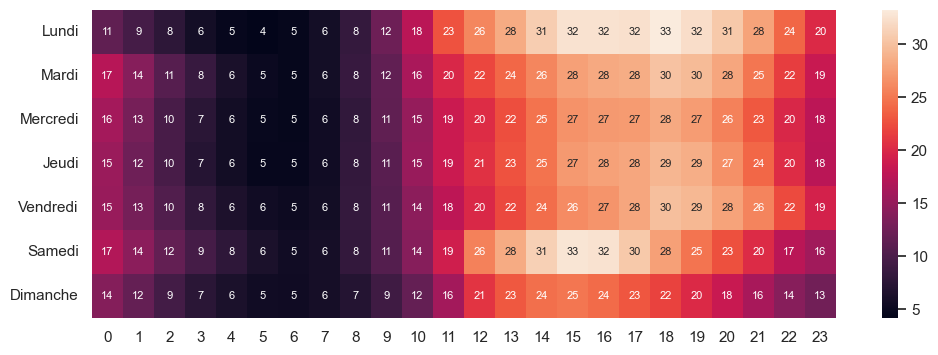

In [120]:
sns.heatmap(tension_day_hour_wait, annot=True, annot_kws={"fontsize":8},fmt=".0f")

In [121]:
tension_month_wait = pd.pivot_table(df3_wait,index=df3_wait.index.month,columns=df3_wait.index.day,
               values='nb_patients',aggfunc='mean')
tension_month_wait.index = index_month

<AxesSubplot:>

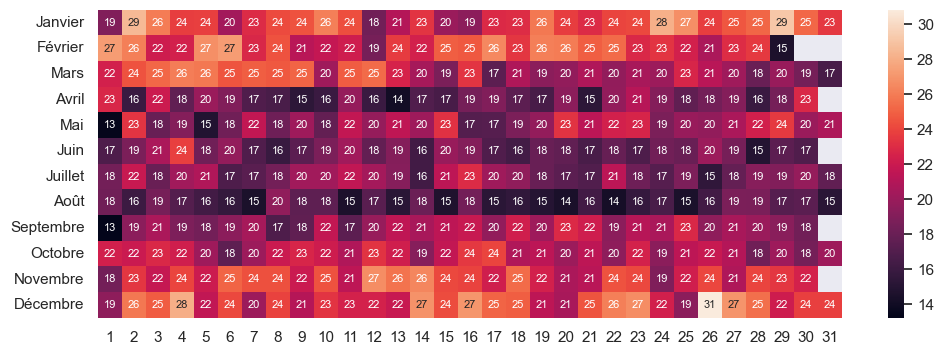

In [122]:
sns.heatmap(tension_month_wait, annot=True, annot_kws={"fontsize":8},fmt=".0f")

utiliser des évènements pour expliquer éventuellement

In [123]:
pd.set_option('display.max_columns', None)
df.head()

,date_arrivee,moyen_arrivee,motif_entree,motif_venue,age,antecedents_medicaux,antecedents_chirurgicaux,pas_pad,fc,temperature,sao2,fr,ccmu,salles,entree_box,anamnese,observation,exam_biologie,exam_radiologie,exam_radiographie,exam_scanner,exam_irm,exam_avis_specialiste,date_presc_bio,date_bio,code_diag,diag_texte,cac_admission,cac_sejour,date_sortie,date_prise_charge,dossier,type_orientation,or_destination,or_trsfert_service,or_trsfert_hop,code_postal,ville,duree_sejour,duree_attente,duree_traitement,count,nb_exam
1,2016-06-01 00:16:00,AMBULANCE PRIVEE,"Malaise, difficulté respi, palpitation, Pas de...",Cardiologie: Palpitations Malaise,33,NaN,NaN,110/56,52,"34,9",97,NaN,1,"((Attente pré IOA,01/06/2016 00:16,01/06/2016 ...",01/06/2016 01:06,MDC: Dyspnée aiguë et palpitations ATCDS: ...,NaN,oui,oui,non,non,non,non,01/06/2016 01:30,01/06/2016 01:35,R06.0,Dyspnée,ACCUEIL SURVEILLANCE ET ADMISSION URGENCE ADUL...,3093,2016-06-01 04:14:00,2016-06-01 01:03:00,NaN,RETOUR DOMICILE,RETOUR DOMICILE,NaN,NaN,59139,WATTIGNIES,0 days 03:58:00,0 days 00:47:00,0 days 03:11:00,1,2
2,2016-06-01 00:18:00,AMBULANCE PRIVEE,"AEG, Hyperthermie et difficulté respi en maiso...",Maladies infectieuses: Hyperthermie,78,NaN,NaN,90/41,77,"36,3",98,NaN,2,"((Attente pré IOA,01/06/2016 00:18,01/06/2016 ...",01/06/2016 01:32,vient pour hyperthermie ATCD: DID retard ...,NaN,oui,oui,non,non,non,non,01/06/2016 01:34,01/06/2016 01:34,R50.9,"Fièvre, sans précision",ACCUEIL SURVEILLANCE ET ADMISSION URGENCE ADUL...,3102,2016-06-01 11:05:00,2016-06-01 02:14:00,NaN,TRANSFERT EXTERNE,Transfert CLINIQUE DUBOIS (LILLE) Motif: Conve...,NaN,CLINIQUE DUBOIS,59310,ORCHIES,0 days 10:47:00,0 days 01:56:00,0 days 08:51:00,1,2
3,2016-06-01 00:36:00,POMPIERS,NaN,NaN,77,NaN,NaN,137/77,97,"36,5",96,21,2,"((Attente pré IOA,01/06/2016 00:36,01/06/2016 ...",01/06/2016 00:41,NaN,NaN,non,non,non,non,non,oui,NaN,NaN,R47.1,Dysarthrie et anarthrie,ACCUEIL SURVEILLANCE ET ADMISSION URGENCE ADUL...,3102,2016-06-01 03:04:00,NaT,NaN,TRANSFERT INTERNE,Admis(e) en NEUROLOGIE B 5 EST (3281/CAC),NEUROLOGIE B 5 EST,NaN,59480,LA BASSEE,0 days 02:28:00,NaT,NaT,1,1
4,2016-06-01 00:43:00,MOYENS PERSONNELS,"1A, Hyperthermie ne cédant pas au paracetamol,...",Maladies infectieuses: Hyperthermie,38,NaN,NaN,117/71,118,"38,2",98,NaN,1,"((Attente pré IOA,01/06/2016 00:43,01/06/2016 ...",01/06/2016 01:36,patient de 38 ans appelant le SAMU pour épisod...,NaN,oui,non,non,non,non,non,01/06/2016 01:40,01/06/2016 01:40,L98.8,Autres affections précisées de la peau et du t...,ACCUEIL SURVEILLANCE ET ADMISSION URGENCE ADUL...,3093,2016-06-01 04:50:00,2016-06-01 01:57:00,NaN,RETOUR DOMICILE,RETOUR DOMICILE,NaN,NaN,59136,WAVRIN,0 days 04:07:00,0 days 01:14:00,0 days 02:53:00,1,1
5,2016-06-01 01:16:00,AMBULANCE PRIVEE,"Douleur bras gauche et mollet gauche, hémiplég...",Cardiologie: Phlébite,69,décembre 2007 : infarctus capsulo caudé droit ...,NaN,137/79,70,"36,1",97,NaN,2,"((Attente pré IOA,01/06/2016 01:16,01/06/2016 ...",01/06/2016 01:36,Patiente de 69 ans amenée pour douleur membre ...,NaN,oui,non,non,non,non,oui,01/06/2016 01:34,01/06/2016 01:35,M79.62,Douleur au niveau d'un membre - Bras,ACCUEIL SURVEILLANCE ET ADMISSION URGENCE ADUL...,3102,2016-06-01 15:55:00,2016-06-01 02:35:00,NaN,RETOUR DOMICILE,RETOUR DOMICILE,NaN,NaN,59130,LAMBERSART,0 days 14:39:00,0 days 01:19:00,0 days 13:20:00,1,2


<font color='RED'><font size='4'>Saisonnalité PAR PATHOLOGIE, moyenne du nombre de patients EN ATTENTE dans le service</font>


On regarde les colonnes et si certraines pourraient nous aider à classer les patients
On en voudrait une avec peu de valeurs uniques si possible, les codes diag sont par exemple trop nombreux (bien qu'on puisse surement les classer)

In [124]:
df.nunique()

date_arrivee                314180
moyen_arrivee                   10
motif_entree                250356
motif_venue                   6843
age                             94
antecedents_medicaux         52969
antecedents_chirurgicaux     31974
pas_pad                      11238
fc                             361
temperature                    109
sao2                           576
fr                             175
ccmu                             7
salles                      336253
entree_box                  175840
anamnese                    177861
observation                  16560
exam_biologie                    2
exam_radiologie                  2
exam_radiographie                2
exam_scanner                     2
exam_irm                         2
exam_avis_specialiste            2
date_presc_bio              160193
date_bio                    156628
code_diag                     5027
diag_texte                    5066
cac_admission                   14
cac_sejour          

<font color='GREEN'><font size='3'>Analyse des pathologies</font>


In [125]:
pathologie = df.motif_venue

In [126]:
pathologie = pathologie.str.split(':',expand=True)

In [127]:
pathologie[0].nunique()

46

Plus que 46 pathos en gardant seulement le texte avant les ":"

In [128]:
pathologies_count = pd.pivot_table(df,index=df['motif_venue'].str.split(':',expand=True)[0],
               values='age',aggfunc='count')

In [129]:
pathologies_count = pathologies_count[pathologies_count.index.str[-1].str.islower()]

In [130]:
pathologies_count = pathologies_count.rename(columns={'age': 'Nombre de patients'})

In [131]:
pathologies_count = pathologies_count.nlargest(11,'Nombre de patients' )

In [132]:
pathologies_count = pathologies_count.drop("Divers")

In [133]:
pathologies_names = pathologies_count.index

In [134]:
pathologies_names = pathologies_names.tolist()

In [135]:
print(pathologies_names)

['Traumatologie', 'Gastro-entérologie', 'Stomatologie', 'Cardiologie', 'Neurologie', 'Orl', 'Rhumatologie non traumatique', 'Uro-néphrologie', 'Pneumologie', 'Psychiatrie']


On créé une liste de toutes les pathos qu'in regroupe dans "autre", il y en a beaucoup  

On examine rapidement toutes les pathos

In [136]:
pathologie = df.motif_venue

In [137]:
pathologie_list = pathologie.to_list()

In [138]:
mauvaises_patho = set([item for item in pathologie_list if item not in pathologies_names])

In [139]:
len(mauvaises_patho)

6844

beaucoup trop de pathos si on considère tout le texte

dictionnaire de toutes les pathos (pas utilisé)

In [140]:
dict_patho = { i : "Autre" for i in mauvaises_patho }


<font color='GREEN'><font size='3'>On va se concentrer sur les pathologies qui representent la majorité des admissions</font>


<font color='GREEN'><font size='3'>On créé une nouvelle colonne dans df</font>


In [141]:
df["pathologie"] = df.motif_venue.str.split(':').str[0]

In [142]:
df.loc[~df["pathologie"].isin(pathologies_names), "pathologie"] = "Autre"


In [143]:
count_in_path = pd.pivot_table(df,index=df['date_arrivee'],columns=df['pathologie'],
               values='age',aggfunc='count')

In [144]:
dict_patho_2 = {i:i+'_2' for i in count_in_path.columns.values}

In [145]:
count_out_path = pd.pivot_table(df,index=df['date_sortie'],columns=df['pathologie'],
               values='age',aggfunc='count')

count_out_path = count_out_path.rename(columns=dict_patho_2)

In [146]:
df_path = pd.concat([count_in_path, count_out_path], axis=1).fillna(0).cumsum()

In [147]:
for i in count_in_path.columns.values:
    df_path[i]= df_path[i]-df_path[i+"_2"]

In [148]:
df_path = df_path.loc[:, ~df_path.columns.str.contains('_2')]

In [149]:
df_path.head()

pathologie,Autre,Cardiologie,Gastro-entérologie,Neurologie,Orl,Pneumologie,Psychiatrie,Rhumatologie non traumatique,Stomatologie,Traumatologie,Uro-néphrologie
2016-06-01 00:16:00,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2016-06-01 00:18:00,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2016-06-01 00:36:00,2.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2016-06-01 00:43:00,3.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2016-06-01 01:16:00,3.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [150]:
l = len(df_path.columns)

In [151]:
df_path.columns[:-5]

Index(['Autre', 'Cardiologie', 'Gastro-entérologie', 'Neurologie', 'Orl',
       'Pneumologie'],
      dtype='object', name='pathologie')

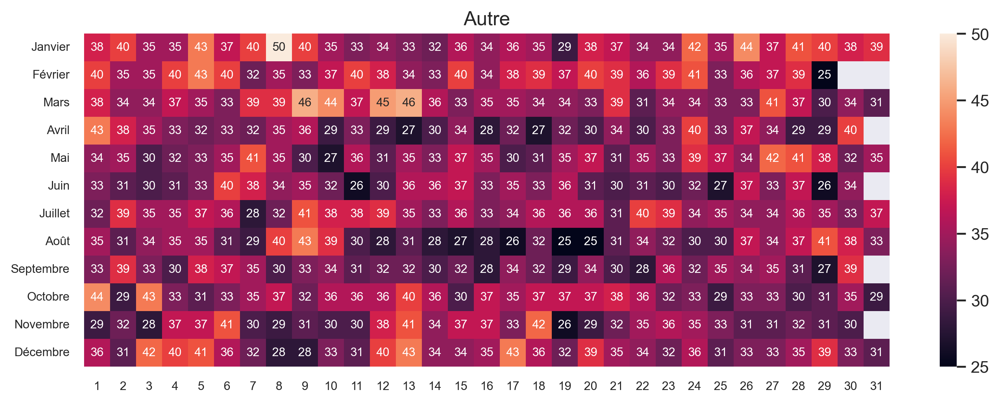

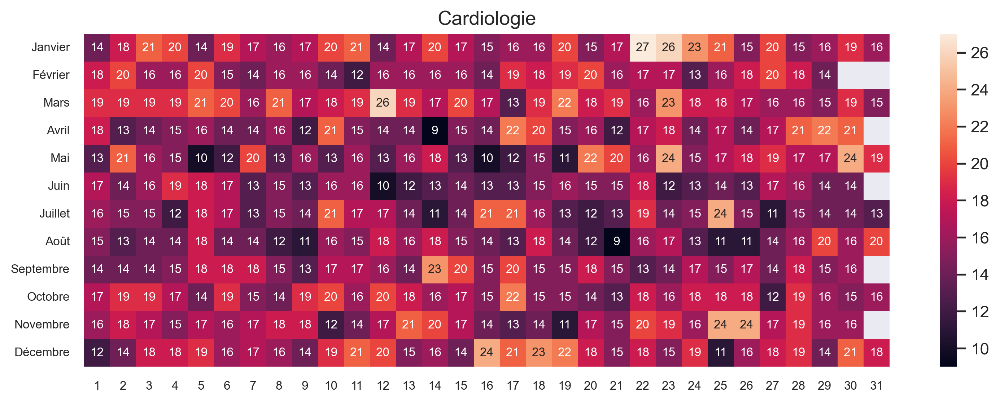

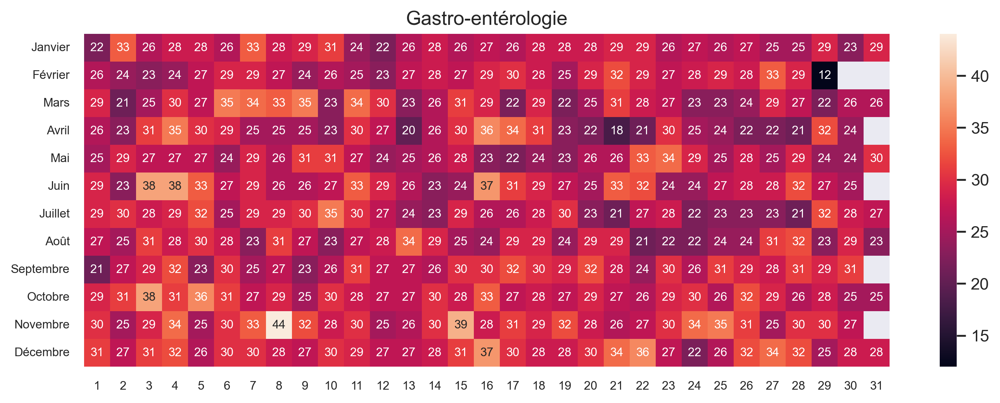

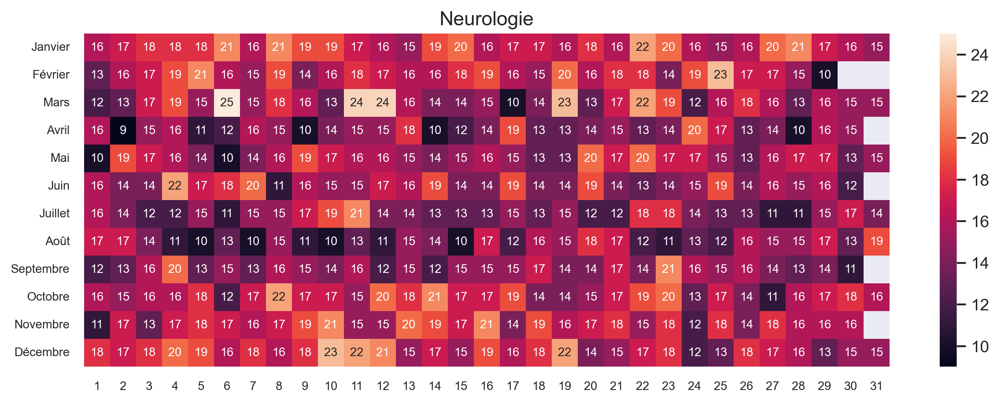

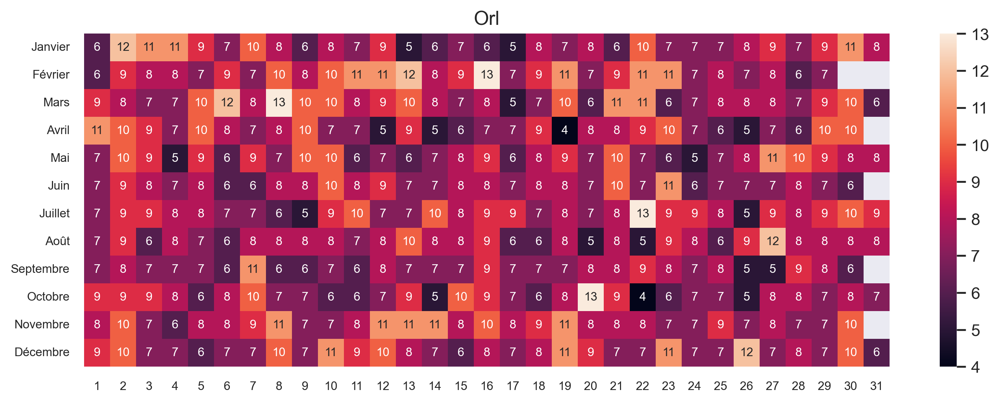

...

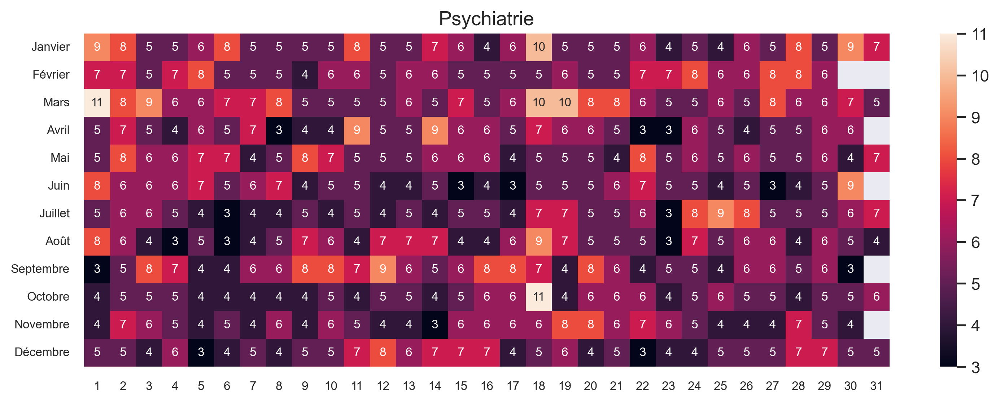

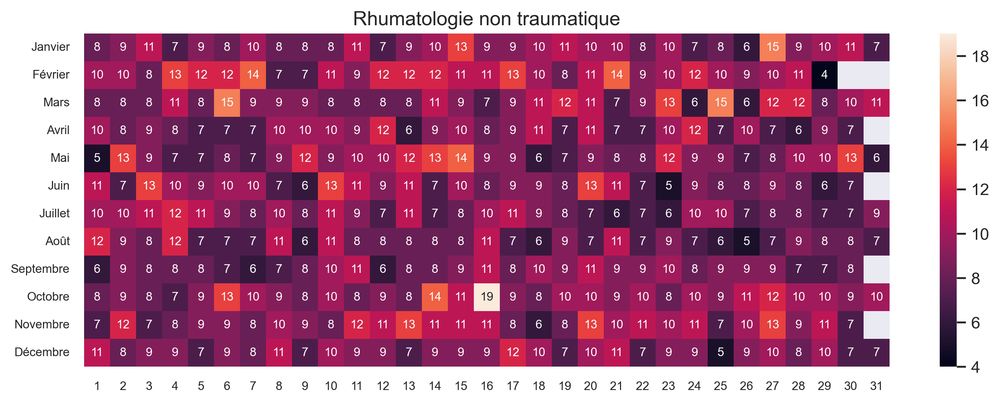

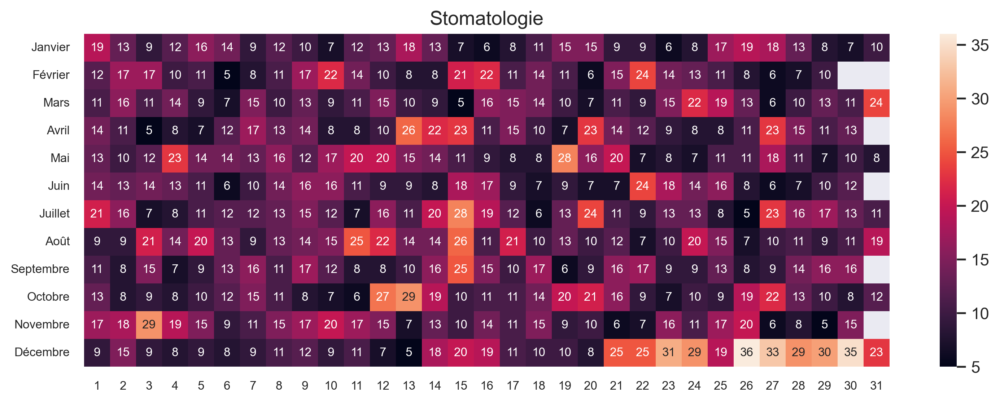

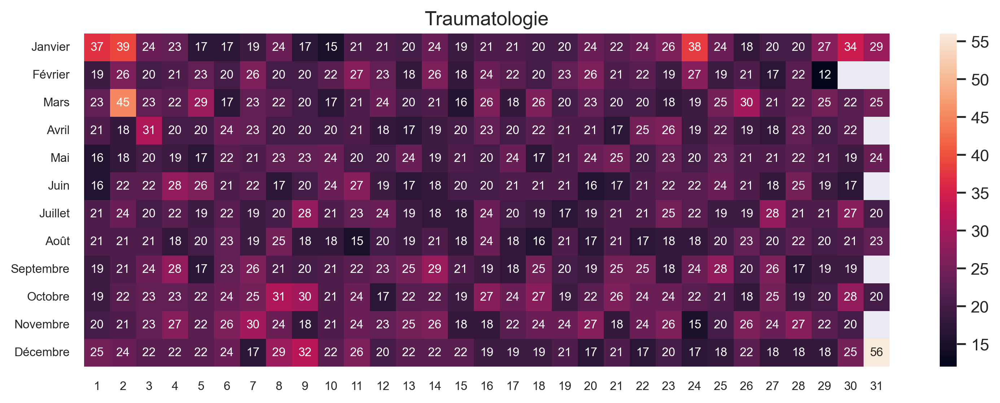

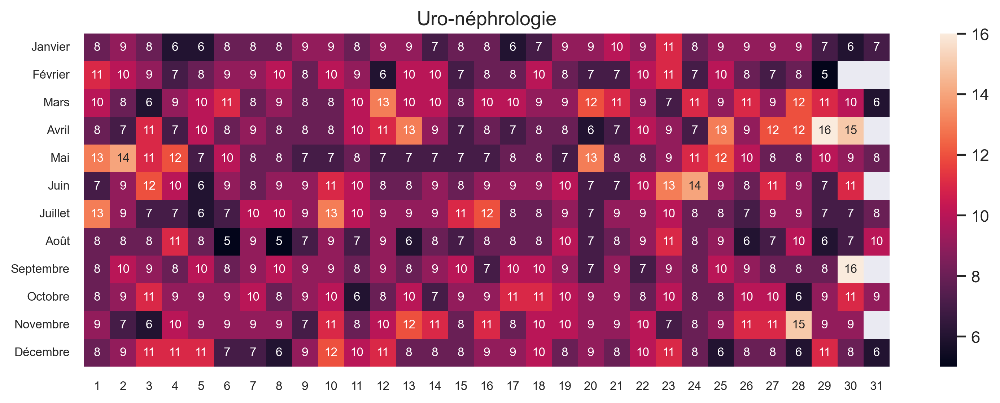

In [152]:
tension_path_list = []
for i in zip(df_path.columns,range(l)):
    fig, ax = plt.subplots(dpi = 300) 
    tension_path_list.append(pd.pivot_table(df_path,index=df_path.index.month,columns=df_path.index.day,
                            values=i[0],aggfunc='max'))
    tension_path_list[i[1]].index = index_month
    
    sns.heatmap(tension_path_list[i[1]], annot=True,fmt=".0f",annot_kws={"fontsize":8},xticklabels=True)
    ax.set_title(i[0],loc='center', fontsize=13)
    ax.tick_params(axis='both', which='major', labelsize=8)
    fig.savefig(r'C:\Users\Tom\Desktop\Work Centrale\G2\IAS\Fil rouge\Cours_Filrouge_BDD\images\pathologies_mois_'+i[0]+'.png',bbox_inches='tight')


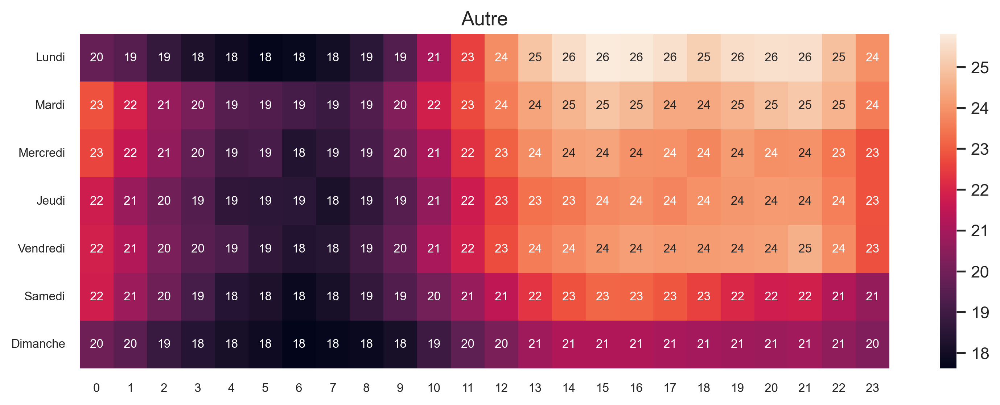

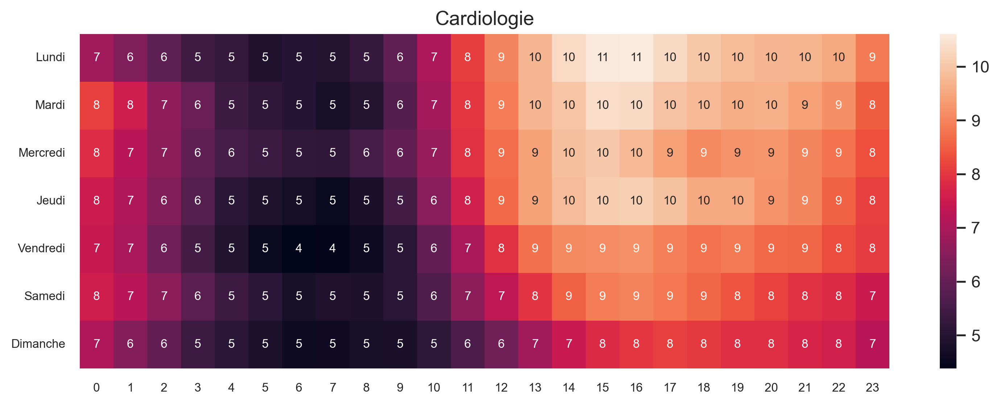

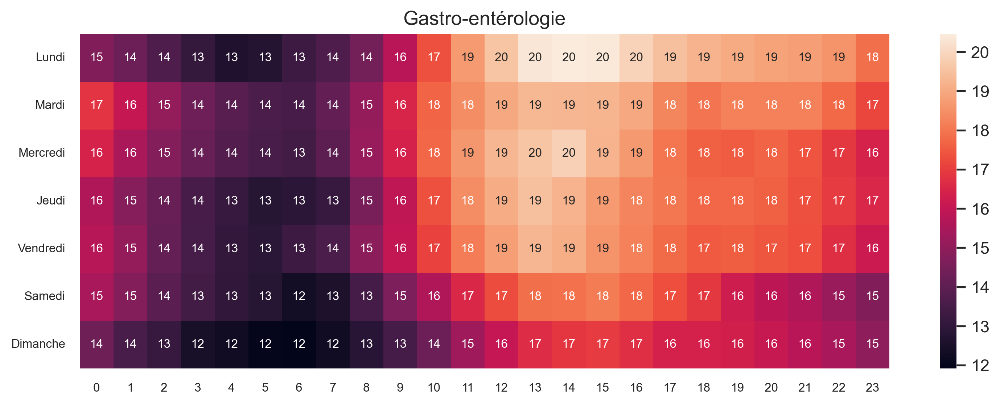

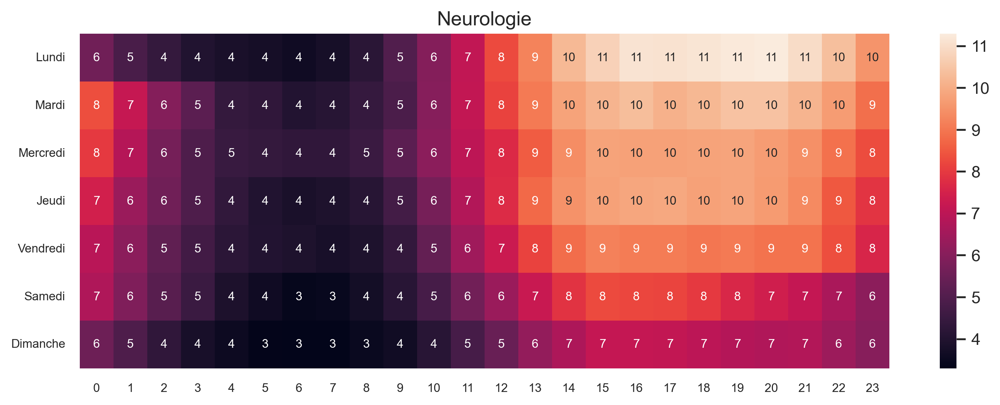

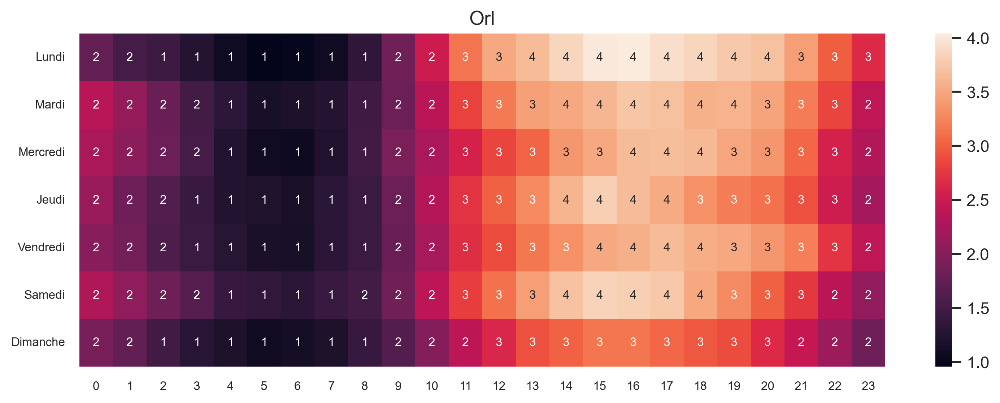

...

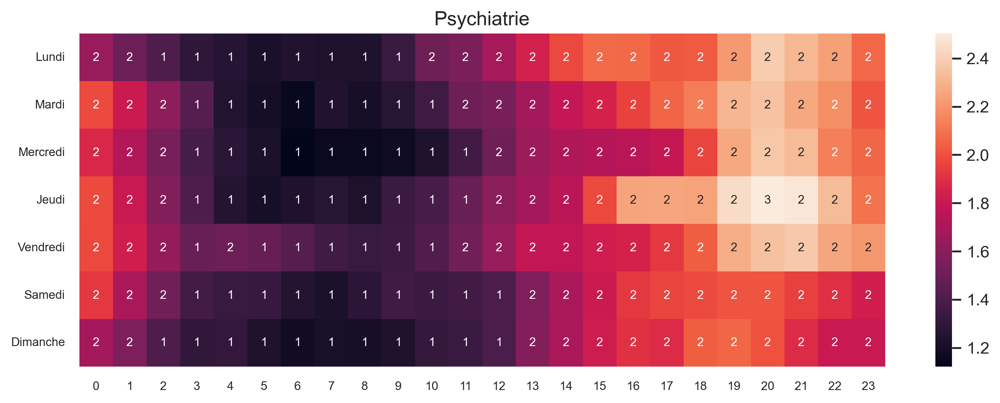

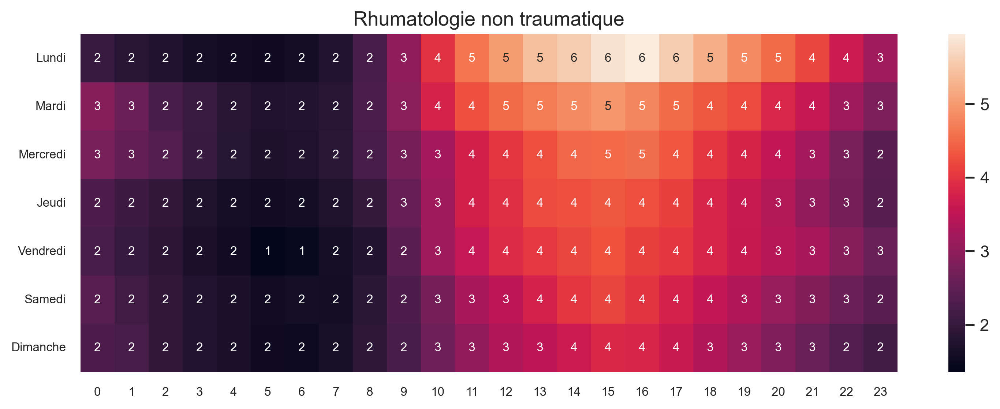

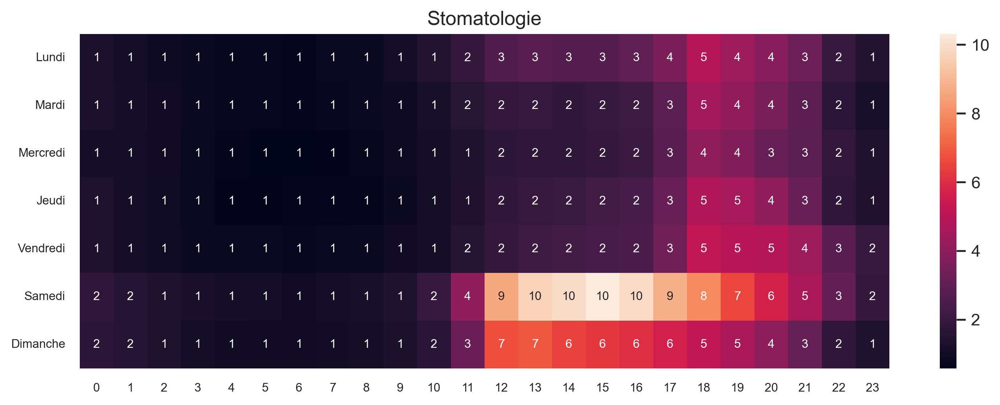

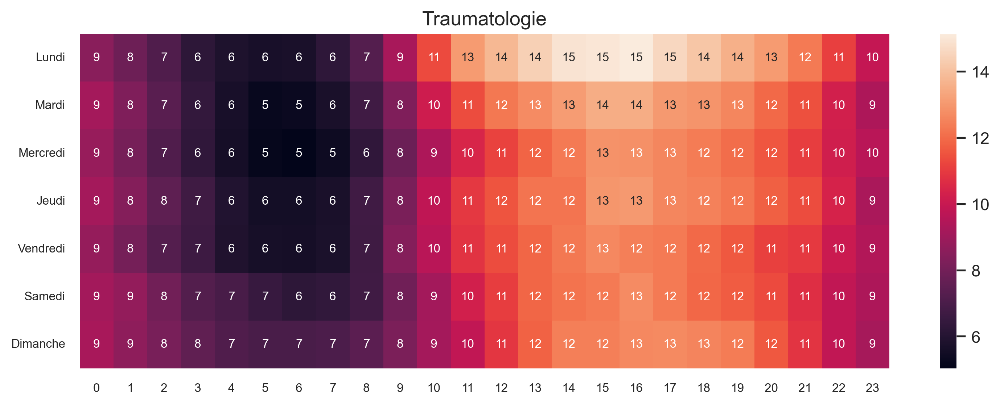

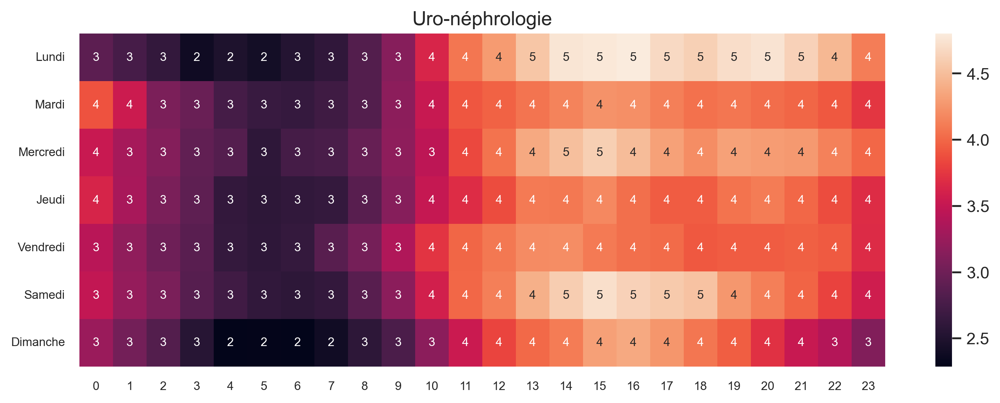

In [153]:
tension_path_list = []
for i in zip(df_path.columns,range(l)):
    fig, ax = plt.subplots(dpi = 300) 
    tension_path_list.append(pd.pivot_table(df_path,index=df_path.index.dayofweek,columns=df_path.index.hour,
                            values=i[0],aggfunc='mean'))
    tension_path_list[i[1]].index = index_dh
    
    sns.heatmap(tension_path_list[i[1]], annot=True,fmt=".0f",annot_kws={"fontsize":8},xticklabels=True)
    ax.set_title(i[0],loc='center', fontsize=13)
    ax.tick_params(axis='both', which='major', labelsize=8)
    fig.savefig(r'C:\Users\Tom\Desktop\Work Centrale\G2\IAS\Fil rouge\Cours_Filrouge_BDD\images\pathologies_dh_'+i[0]+'.png',bbox_inches='tight')


fig, axs = plt.subplots(nrows = l-5, figsize = (13,29.7), dpi = 300) 
tension_path_list = []

for i in zip(df_path.columns[:-5],range(l-5)):
    tension_path_list.append(pd.pivot_table(df_path,index=df_path.index.month,columns=df_path.index.day,
                            values=i[0],aggfunc='mean'))
    tension_path_list[i[1]].index = index_month
    
    sns.heatmap(tension_path_list[i[1]], annot=True,fmt=".0f",annot_kws={"fontsize":8},xticklabels=True, ax=axs[i[1]])
    axs[i[1]].set_xlabel(i[0],loc='center', fontsize=10)
    axs[i[1]].tick_params(axis='both', which='major', labelsize=8)
    plt.tight_layout()
    


fig.savefig(r'C:\Users\Tom\Desktop\Work Centrale\G2\IAS\Fil rouge\Cours_Filrouge_BDD\images\pathologies_mois_p1.png',bbox_inches='tight')


fig, axs = plt.subplots(nrows = l, figsize = (13,29.7), dpi = 300) 
tension_path_list = []

for i in zip(df_path.columns[-5:],range(l-5,l)):
    tension_path_list.append(pd.pivot_table(df_path,index=df_path.index.month,columns=df_path.index.day,
                            values=i[0],aggfunc='mean'))
    tension_path_list[i[1]].index = index_month
    
    sns.heatmap(tension_path_list[i[1]], annot=True,fmt=".0f",annot_kws={"fontsize":8},xticklabels=True, ax=axs[i[1]])
    axs[i[1]].set_xlabel(i[0],loc='center', fontsize=10)
    axs[i[1]].tick_params(axis='both', which='major', labelsize=8)
    plt.tight_layout()

fig.savefig(r'C:\Users\Tom\Desktop\Work Centrale\G2\IAS\Fil rouge\Cours_Filrouge_BDD\images\pathologies_mois.png',bbox_inches='tight')


Il faudrait réduire la taille de la police de la colorbar et eventuellement set un format entier et pas float

Faisons la même chose avec une saisonnalité hebdomadaire

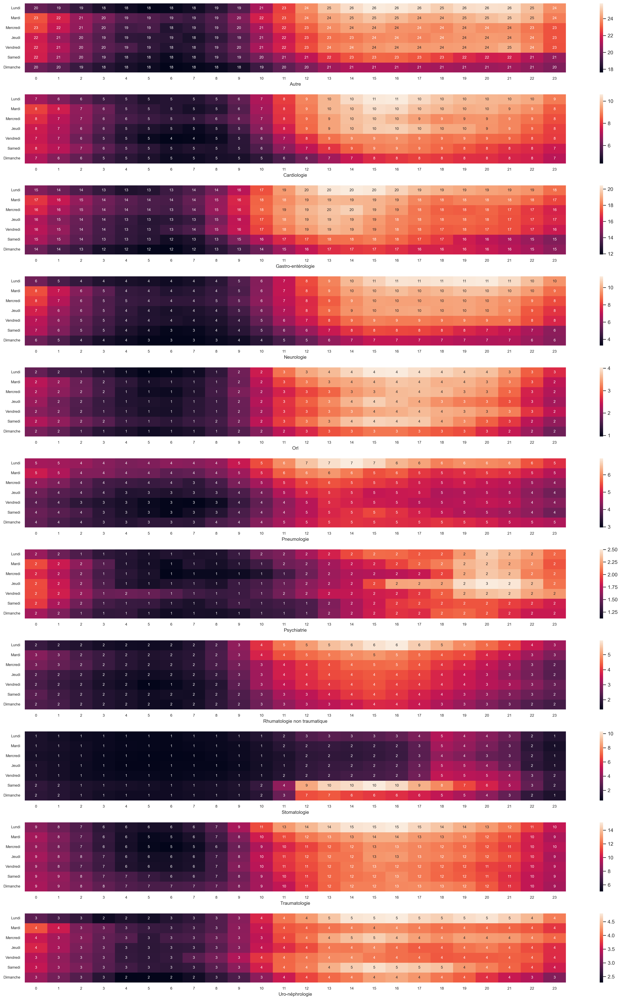

In [154]:
fig, axs = plt.subplots(nrows = l, figsize = (21,29.7), dpi = 300) 
tension_path_list = []

for i in zip(df_path.columns,range(l)):
    tension_path_list.append(pd.pivot_table(df_path,index=df_path.index.dayofweek,columns=df_path.index.hour,
                            values=i[0],aggfunc='mean'))
    tension_path_list[i[1]].index = index_dh
    
    sns.heatmap(tension_path_list[i[1]], annot=True,fmt=".0f",annot_kws={"fontsize":8},xticklabels=True, ax=axs[i[1]])
    axs[i[1]].set_xlabel(i[0],loc='center', fontsize=10)
    axs[i[1]].tick_params(axis='both', which='major', labelsize=8)
    plt.tight_layout()

In [155]:
fig.savefig(r'C:\Users\Tom\Desktop\Work Centrale\G2\IAS\Fil rouge\Cours_Filrouge_BDD\images\pathologies_dh.png',bbox_inches='tight')


<font color='RED'><font size='4'>Transferts</font>


In [156]:
df.or_destination.iloc[343]

'Transfert CH SECLIN (SECLIN) Motif: Absence de lit disponible  '

In [157]:
df[df.or_destination.str.contains("transfert", case=False)]

,date_arrivee,moyen_arrivee,motif_entree,motif_venue,age,antecedents_medicaux,antecedents_chirurgicaux,pas_pad,fc,temperature,sao2,fr,ccmu,salles,entree_box,anamnese,observation,exam_biologie,exam_radiologie,exam_radiographie,exam_scanner,exam_irm,exam_avis_specialiste,date_presc_bio,date_bio,code_diag,diag_texte,cac_admission,cac_sejour,date_sortie,date_prise_charge,dossier,type_orientation,or_destination,or_trsfert_service,or_trsfert_hop,code_postal,ville,duree_sejour,duree_attente,duree_traitement,count,nb_exam,pathologie
2,2016-06-01 00:18:00,AMBULANCE PRIVEE,"AEG, Hyperthermie et difficulté respi en maiso...",Maladies infectieuses: Hyperthermie,78,NaN,NaN,90/41,77,"36,3",98,NaN,2,"((Attente pré IOA,01/06/2016 00:18,01/06/2016 ...",01/06/2016 01:32,vient pour hyperthermie ATCD: DID retard ...,NaN,oui,oui,non,non,non,non,01/06/2016 01:34,01/06/2016 01:34,R50.9,"Fièvre, sans précision",ACCUEIL SURVEILLANCE ET ADMISSION URGENCE ADUL...,3102,2016-06-01 11:05:00,2016-06-01 02:14:00,NaN,TRANSFERT EXTERNE,Transfert CLINIQUE DUBOIS (LILLE) Motif: Conve...,NaN,CLINIQUE DUBOIS,59310,ORCHIES,0 days 10:47:00,0 days 01:56:00,0 days 08:51:00,1,2,Autre
140,2016-06-01 16:24:00,AMBULANCE PRIVEE,"agitation , agressivité","Psychiatrie: Agitation, agressivité",24,Asthme dans l'enfance plusieurs épisodes de p...,NaN,139/97,93,"36,8",98,NaN,P,"((Attente pré IOA,01/06/2016 16:24,01/06/2016 ...",NaN,Patiente adressée par le centre de santé des é...,NaN,non,non,non,non,non,oui,NaN,NaN,F92.8,Autres troubles mixtes des conduites et troubl...,ACCUEIL SURVEILLANCE ET ADMISSION URGENCE ADUL...,3103,2016-06-01 20:15:00,2016-06-01 16:46:00,NaN,TRANSFERT EXTERNE,Transfert CPAA (LILLE),NaN,CPAA,59100,ROUBAIX,0 days 03:51:00,0 days 00:22:00,0 days 03:29:00,1,1,Psychiatrie
146,2016-06-01 16:46:00,AMBULANCE PRIVEE,syndrome depressif IDS suivie au cmp de faches,Psychiatrie: Idées suicidaires,35,neuropathie suite à un coma de 2 mois 2014 sou...,NaN,43993,68,36,98,NaN,3,"((Attente pré IOA,01/06/2016 16:46,01/06/2016 ...",NaN,Patient me dit avoir été e garde a vue il y a ...,alprazolam 0.5 x 4 / j mianserine lyrica larox...,oui,non,non,non,non,oui,01/06/2016 18:54,01/06/2016 18:54,F33.8,Autres troubles dépressifs récurrents,URGENCE CIRCUIT COURT (3088/CAC),3083,2016-06-02 11:42:00,2016-06-01 19:02:00,NaN,TRANSFERT EXTERNE,Transfert CTR HOSP ARMENTIERES (ARMENTIERES),NaN,CTR HOSP ARMENTIERES,59810,LESQUIN,0 days 18:56:00,0 days 02:16:00,0 days 16:40:00,1,2,Psychiatrie
344,2016-06-02 15:37:00,POMPIERS,Douleur abdominale,Gastro-entérologie: Douleur abdominale brutale...,67,NaN,NaN,148/96,70,"36,5",90 AA,16,2,"((Attente pré IOA,02/06/2016 15:37,02/06/2016 ...",02/06/2016 15:38,Motif: douleur épigastrique brutale ce midi ...,NaN,oui,oui,oui,non,non,non,02/06/2016 15:41,02/06/2016 15:41,R10.1,Douleur localisée à la partie supérieure de l'...,ACCUEIL SURVEILLANCE ET ADMISSION URGENCE ADUL...,3102,2016-06-02 22:12:00,2016-06-02 15:38:00,NaN,TRANSFERT EXTERNE,Transfert CH SECLIN (SECLIN) Motif: Absence de...,NaN,CH SECLIN,59710,AVELIN,0 days 06:35:00,0 days 00:01:00,0 days 06:34:00,1,3,Gastro-entérologie
382,2016-06-02 18:41:00,AMBULANCE PRIVEE,IRA creat=40 sur IRC,Uro-néphrologie: insuffisance rénale aigue,74,DID,ULCERE ESCARRES,201/86,92,36,98,NaN,2,"((Attente pré IOA,02/06/2016 18:41,02/06/2016 ...",02/06/2016 19:37,MC : IRA sur IRC diabétique Ses facteurs de...,NaN,oui,non,oui,non,non,non,02/06/2016 20:06,02/06/2016 20:11,N17.8,Autres insuffisances rénales aiguës,ACCUEIL SURVEILLANCE ET ADMISSION URGENCE ADUL...,3083,2016-06-03 11:19:00,2016-06-02 19:47:00,NaN,TRANSFERT EXTERNE,Transfert POLYCLINIQUE DU BOIS (LILLE),NaN,POLYCLINIQUE DU BOIS,59650,VILLENEUVE D ASCQ,0 days 16:38:00,0 days 01:06:00,0 days 15:32:00,1,2,Uro-néphrologie
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
336115,2020-06-01 09:23:00,AMBULANCE PRIVEE,NaN,NaN,59,NaN,Na

In [158]:
test_tsf = df.or_destination

In [159]:
test_tsf = test_tsf.value_counts()

In [160]:
test_tsf

RETOUR DOMICILE                                                                                               237648
NON PRIS EN CHARGE                                                                                             10705
PARTIE SANS ATTENDRE                                                                                            7241
Admis(e) en SOINS INTENSIFS NEUROVASCULAIRES (3303/CAC)                                                         3347
Admis(e) en MÉDECINE POLYVALENTE POST URGENCE (2250/CAC)                                                        3232
                                                                                                               ...  
RETOUR DOMICILE Consultation externe le/dans 13/02/2018 au service : CONSULTATION TRAUMATOLOGIE (3968/CAC)         1
RETOUR DOMICILE Consultation externe le/dans 16/02/2018                                                            1
Transfert C H ROUBAIX RÉANIMATION MÉDICALE (ROUBAIX) Motif: Urge

In [161]:
count_tsf = df[df.type_orientation == "TRANSFERT EXTERNE"].groupby('date_sortie')['date_sortie'].count()

In [162]:
count_tsf = count_tsf.resample("M").sum()

In [163]:
count_tsf.index = pd.to_datetime(count_tsf.index, format = '%Y/%m/%d').strftime('%Y/%m')

In [164]:
count_tsf.index

Index(['2016/06', '2016/07', '2016/08', '2016/09', '2016/10', '2016/11',
       '2016/12', '2017/01', '2017/02', '2017/03', '2017/04', '2017/05',
       '2017/06', '2017/07', '2017/08', '2017/09', '2017/10', '2017/11',
       '2017/12', '2018/01', '2018/02', '2018/03', '2018/04', '2018/05',
       '2018/06', '2018/07', '2018/08', '2018/09', '2018/10', '2018/11',
       '2018/12', '2019/01', '2019/02', '2019/03', '2019/04', '2019/05',
       '2019/06', '2019/07', '2019/08', '2019/09', '2019/10', '2019/11',
       '2019/12', '2020/01', '2020/02', '2020/03', '2020/04', '2020/05',
       '2020/06'],
      dtype='object', name='date_sortie')

In [165]:
count_tsf

date_sortie
2016/06    148
2016/07    169
2016/08    155
2016/09    134
2016/10    172
2016/11    154
2016/12    158
2017/01    149
2017/02    156
2017/03    144
2017/04    120
2017/05    120
2017/06    126
2017/07    168
2017/08    122
2017/09    145
2017/10    140
2017/11    164
2017/12    159
2018/01    142
2018/02    126
2018/03    120
2018/04    137
2018/05    117
2018/06    131
2018/07    127
2018/08    141
2018/09    136
2018/10    125
2018/11    153
2018/12    135
2019/01    149
2019/02    147
2019/03    154
2019/04    147
2019/05    122
2019/06    131
2019/07    134
2019/08    149
2019/09    135
2019/10    163
2019/11    134
2019/12    159
2020/01    154
2020/02    160
2020/03    118
2020/04     94
2020/05    139
2020/06     10
Name: date_sortie, dtype: int64

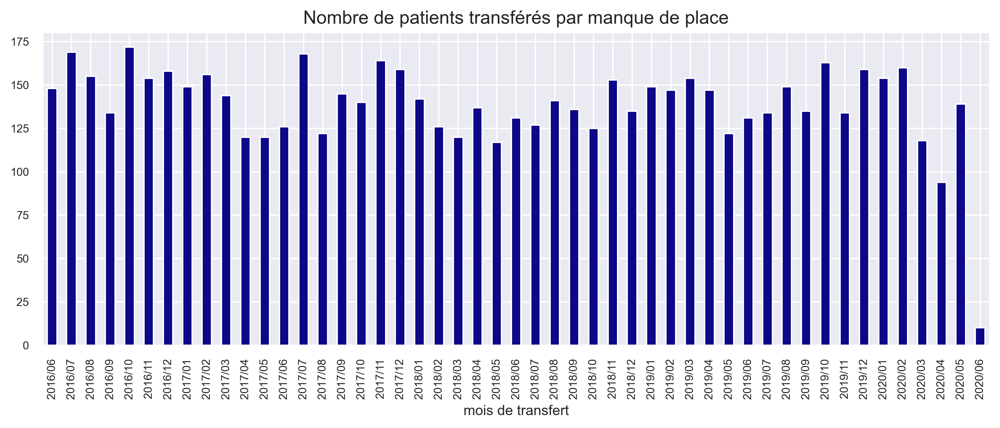

In [166]:
fig,ax = plt.subplots(dpi=300)
count_tsf.plot(kind='bar',fontsize=8,colormap='plasma')

ax.set_title("Nombre de patients transférés par manque de place", fontsize=13)
ax.set_xlabel("mois de transfert",fontsize=10)
fig.savefig('tsf_place.png',bbox_inches='tight')

<font color='RED'><font size='4'>Saisonnalité PAR CCMU, moyenne du nombre de patients présents dans le service</font>


On peut utiliser la date d'entree ou date prise en charge, assez proches pour les CCMU graves mais pas pour les petits

In [167]:
df.ccmu.value_counts()

2    229295
1     33293
3     19637
P      6068
4      2864
5      1738
D       227
Name: ccmu, dtype: int64

In [168]:
count_in_ccmu = pd.pivot_table(df,index=df['date_arrivee'],columns=df['ccmu'],
               values='age',aggfunc='count')

dict_ccmu_2 = {i:i+'_2' for i in count_in_ccmu.columns.values}

count_out_ccmu = pd.pivot_table(df,index=df['date_sortie'],columns=df['ccmu'],
               values='age',aggfunc='count')

count_out_ccmu = count_out_ccmu.rename(columns=dict_ccmu_2)

df_ccmu = pd.concat([count_in_ccmu, count_out_ccmu], axis=1).fillna(0).cumsum()

for i in count_in_ccmu.columns.values:
    df_ccmu[i]= df_ccmu[i]-df_ccmu[i+"_2"]

df_ccmu = df_ccmu.loc[:, ~df_ccmu.columns.str.contains('_2')]

df_ccmu.head()

ccmu,1,2,3,4,5,D,P
2016-06-01 00:16:00,1.0,0.0,0.0,0.0,0.0,0.0,0.0
2016-06-01 00:18:00,1.0,1.0,0.0,0.0,0.0,0.0,0.0
2016-06-01 00:36:00,1.0,2.0,0.0,0.0,0.0,0.0,0.0
2016-06-01 00:43:00,2.0,2.0,0.0,0.0,0.0,0.0,0.0
2016-06-01 01:16:00,2.0,3.0,0.0,0.0,0.0,0.0,0.0


Que s'est il passé le 13/11?

In [169]:
nov_ccmu = df_ccmu.loc[(df_ccmu.index.month == 11) & (df_ccmu.index.day == 13)]

In [170]:
nov_ccmu.head()

ccmu,1,2,3,4,5,D,P
2016-11-13 00:03:00,1.0,30.0,12.0,0.0,2.0,3.0,0.0
2016-11-13 00:05:00,1.0,31.0,12.0,0.0,2.0,3.0,0.0
2016-11-13 00:26:00,1.0,30.0,12.0,0.0,2.0,3.0,0.0
2016-11-13 00:31:00,1.0,31.0,12.0,0.0,2.0,3.0,0.0
2016-11-13 00:37:00,1.0,31.0,12.0,0.0,2.0,3.0,0.0


In [171]:
nov_ccmu.resample("Y").max()

ccmu,1,2,3,4,5,D,P
2016-12-31,10.0,61.0,21.0,3.0,2.0,3.0,1.0
2017-12-31,11.0,82.0,16.0,5.0,9.0,3.0,2.0
2018-12-31,12.0,67.0,13.0,1.0,0.0,0.0,4.0
2019-12-31,12.0,64.0,6.0,0.0,0.0,1.0,3.0


In [172]:
df.loc[(df.date_arrivee.dt.month == 11) & (df.date_arrivee.dt.day > 6) & (df.date_arrivee.dt.day < 20) & (df.ccmu == "D")].head()

,date_arrivee,moyen_arrivee,motif_entree,motif_venue,age,antecedents_medicaux,antecedents_chirurgicaux,pas_pad,fc,temperature,sao2,fr,ccmu,salles,entree_box,anamnese,observation,exam_biologie,exam_radiologie,exam_radiographie,exam_scanner,exam_irm,exam_avis_specialiste,date_presc_bio,date_bio,code_diag,diag_texte,cac_admission,cac_sejour,date_sortie,date_prise_charge,dossier,type_orientation,or_destination,or_trsfert_service,or_trsfert_hop,code_postal,ville,duree_sejour,duree_attente,duree_traitement,count,nb_exam,pathologie
36524,2016-11-08 18:06:00,AMB PUBLIQUE CHRU,NaN,NaN,55,Maladie de Crohn Phlébites surdité bilatéral...,Gliosarcome frontal gauche carcinome épidermo...,90/55,75,"36,5",94,19,D,"((Attente,08/11/2016 18:06,08/11/2016 18:07),(...",NaN,NaN,NaN,oui,oui,non,non,oui,oui,08/11/2016 22:30,09/11/2016 07:00,C72.8,Tumeur maligne à localisations contiguës de l'...,ANEST RÉA SOINS INTENSIFS (3082/CAC),3082,2016-11-15 01:02:00,2016-11-08 18:48:00,NaN,DECES,DECES,NaN,NaN,59270,BERTHEN,6 days 06:56:00,0 days 00:42:00,6 days 06:14:00,1,4,Autre
37055,2016-11-11 06:24:00,SAMU-SMUR,NaN,NaN,49,NaN,NaN,NaN,NaN,NaN,NaN,NaN,D,"((Attente,11/11/2016 06:24,11/11/2016 06:34),(...",NaN,NaN,NaN,non,non,non,non,non,oui,NaN,NaN,I46.9,"Arrêt cardiaque, sans précision",ANEST RÉA SOINS INTENSIFS (3082/CAC),3082,2016-11-11 10:04:00,2016-11-11 08:24:00,NaN,DECES,DECES,NaN,NaN,59148,FLINES LEZ RACHES,0 days 03:40:00,0 days 02:00:00,0 days 01:40:00,1,1,Autre
37269,2016-11-11 22:35:00,AMB PUBLIQUE CHRU,NaN,NaN,68,NaN,NaN,139/55,101,"36,4",100,20,D,"((Attente,11/11/2016 22:35,11/11/2016 22:53),(...",12/11/2016 05:02,NaN,NaN,non,oui,non,non,non,oui,NaN,NaN,Z52.9,Donneur d'organe ou de tissu non précisés,ANEST RÉA SOINS INTENSIFS (3082/CAC),3082,2016-11-12 11:00:00,2016-11-11 23:18:00,NaN,DECES,DECES,NaN,NaN,59480,LA BASSEE,0 days 12:25:00,0 days 00:43:00,0 days 11:42:00,1,2,Autre
37464,2016-11-12 19:29:00,AUTRES,coma profond / astrocytome,Neuro-chirurgie: Transfert SMUR pour prise en ...,30,NaN,NaN,NaN,NaN,NaN,NaN,NaN,D,"((Attente,12/11/2016 19:29,12/11/2016 19:37),(...",NaN,NaN,NaN,non,non,non,oui,non,oui,NaN,NaN,G93.6,Oedème cérébral,ANEST RÉA SOINS INTENSIFS (3082/CAC),3082,2016-11-13 14:30:00,2016-11-12 19:53:00,NaN,DECES,DECES,NaN,NaN,59780,WILLEMS,0 days 19:01:00,0 days 00:24:00,0 days 18:37:00,1,2,Autre
37492,2016-11-12 23:49:00,SAMU-SMUR,NaN,NaN,72,NaN,NaN,140/71,88,"35,3",99,20,D,"((Attente,12/11/2016 23:49,13/11/2016 00:57),(...",NaN,"Femme de 78 ans, TC grave. Atcd: à priori ...",NaN,oui,oui,non,oui,non,oui,13/11/2016 12:00,13/11/2016 13:20,I61.6,"Hémorragie intracérébrale, localisations multi...",ANEST RÉA SOINS INTENSIFS (3082/CAC),3082,2016-11-14 03:00:00,2016-11-12 23:59:00,NaN,DECES,DECES,NaN,NaN,62300,LENS,1 days 03:11:00,0 days 00:10:00,1 days 03:01:00,1,4,Autre


FIn analyse 13/11

In [173]:
l_ccmu = len(df_ccmu.columns)

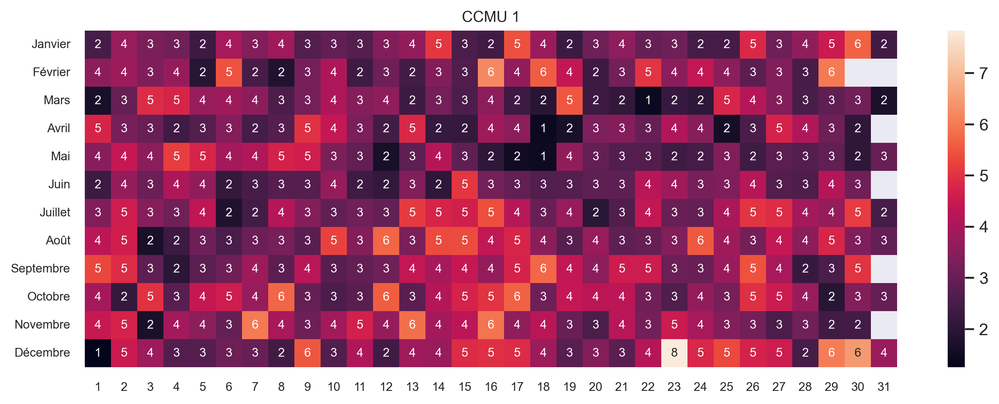

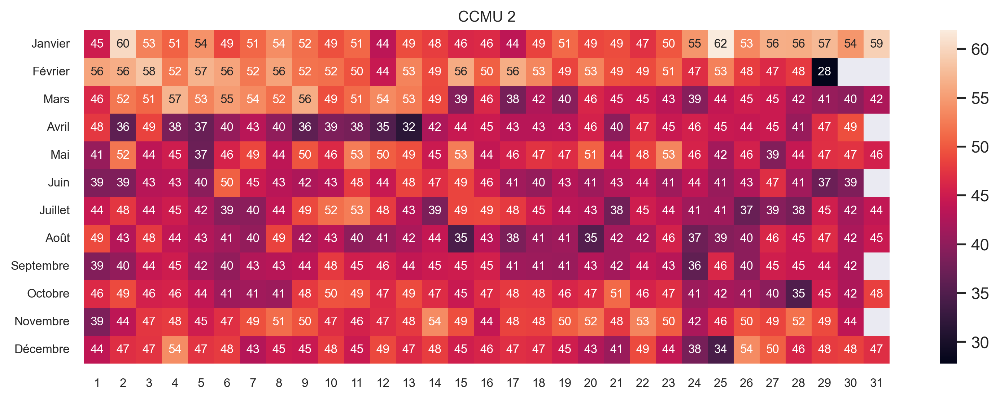

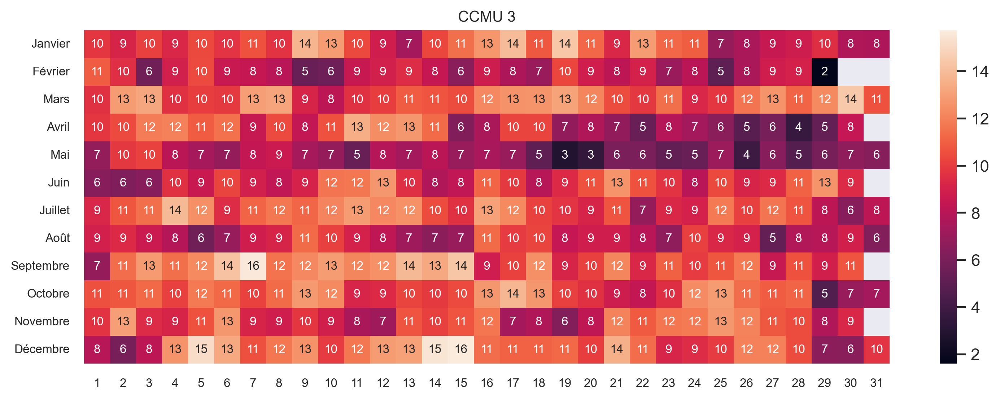

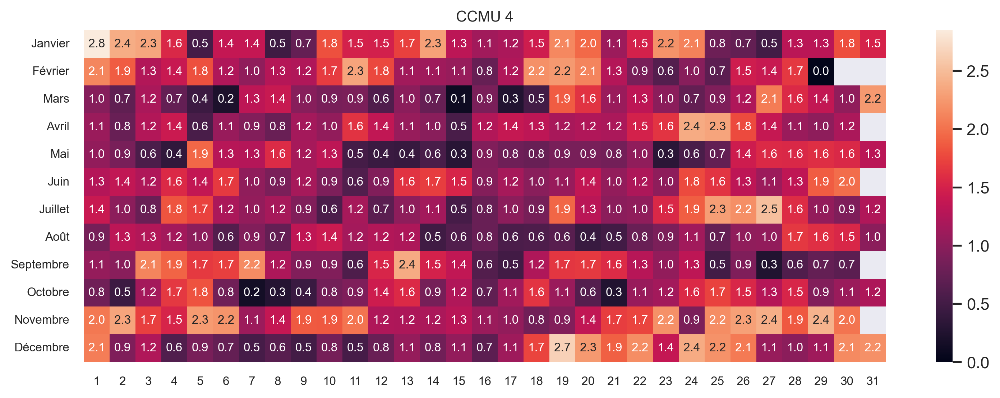

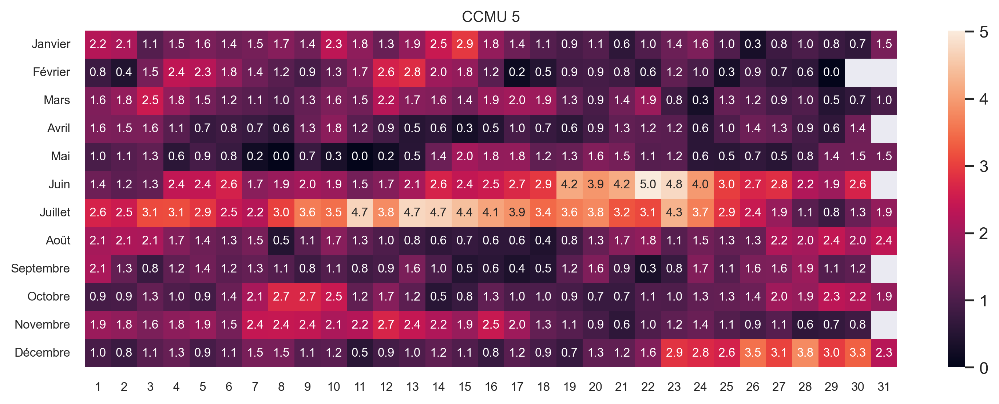

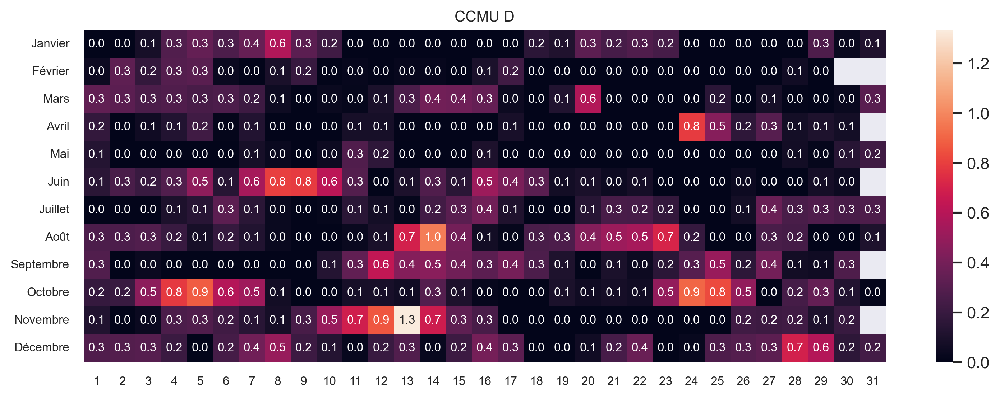

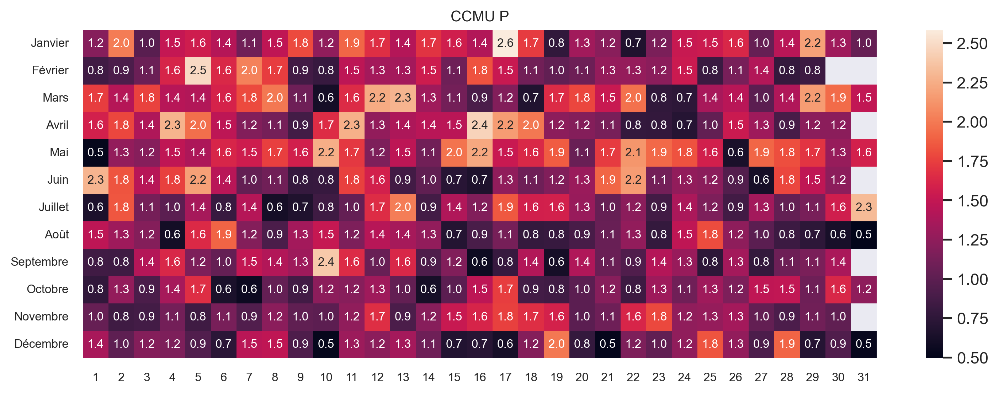

In [174]:
tension_ccmu_list = []

for i in zip(df_ccmu.columns,range(l_ccmu-4)):
    fig, ax = plt.subplots(dpi = 300) 
    tension_ccmu_list.append(pd.pivot_table(df_ccmu,index=df_ccmu.index.month,columns=df_ccmu.index.day,
                            values=i[0],aggfunc='mean'))
    tension_ccmu_list[i[1]].index = index_month        
    
    sns.heatmap(tension_ccmu_list[i[1]], annot=True,fmt=".0f",annot_kws={"fontsize":8},xticklabels=True)
    ax.set_title("CCMU "+str(i[0]),loc='center', fontsize=10)
    ax.tick_params(axis='both', which='major', labelsize=8)
    fig.savefig(r'C:\Users\Tom\Desktop\Work Centrale\G2\IAS\Fil rouge\Cours_Filrouge_BDD\images\ccmu_mois_'+i[0]+'.png',bbox_inches='tight')
    
for i in zip(["4","5","D","P"],range(l_ccmu-4,l_ccmu)):
    fig, ax = plt.subplots(dpi = 300) 
    tension_ccmu_list.append(pd.pivot_table(df_ccmu,index=df_ccmu.index.month,columns=df_ccmu.index.day,
                            values=i[0],aggfunc='mean'))
    tension_ccmu_list[i[1]].index = index_month        
    
    sns.heatmap(tension_ccmu_list[i[1]], annot=True,fmt=".1f",annot_kws={"fontsize":8},xticklabels=True)
    ax.set_title("CCMU "+str(i[0]),loc='center', fontsize=10)
    ax.tick_params(axis='both', which='major', labelsize=8)
    fig.savefig(r'C:\Users\Tom\Desktop\Work Centrale\G2\IAS\Fil rouge\Cours_Filrouge_BDD\images\ccmu_mois_'+i[0]+'.png',bbox_inches='tight')
    

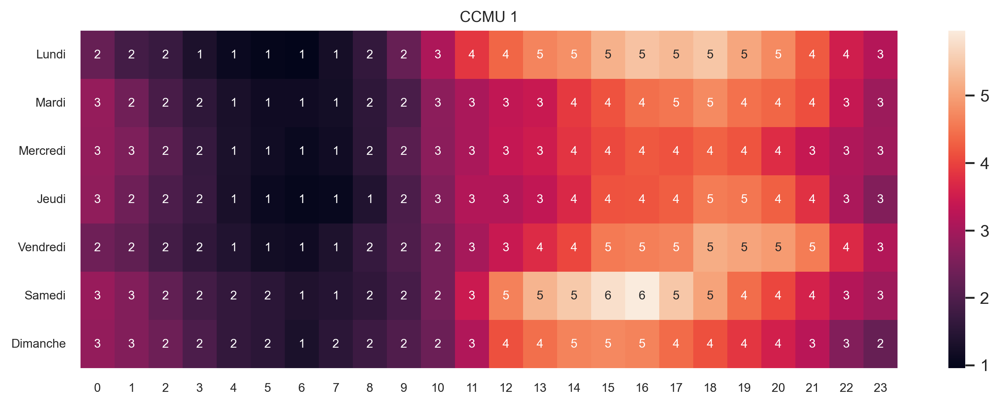

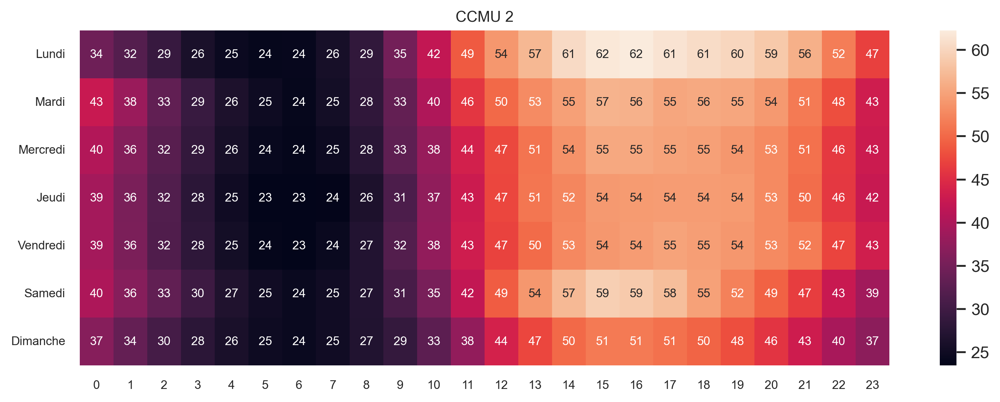

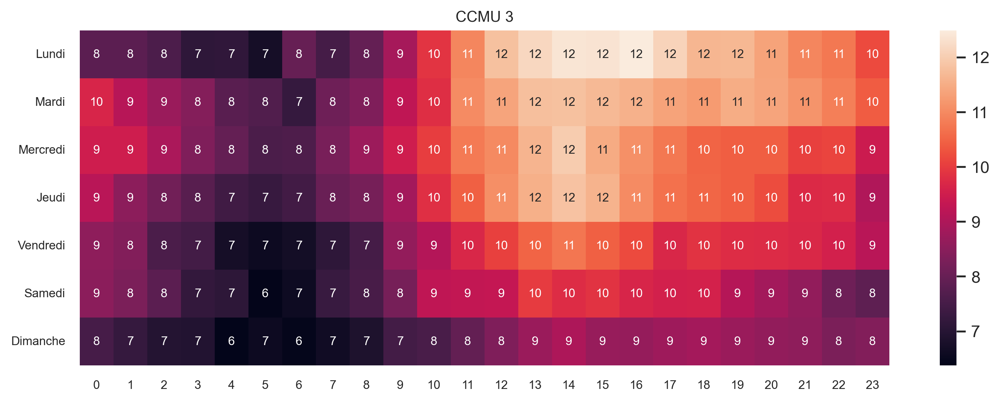

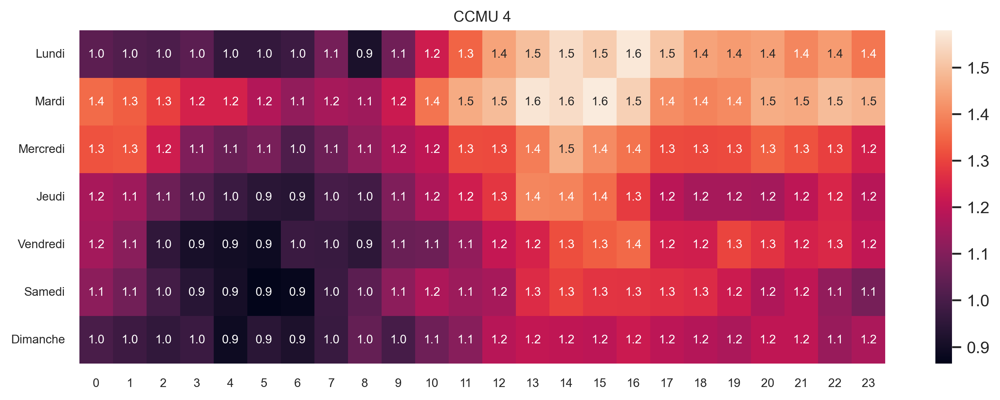

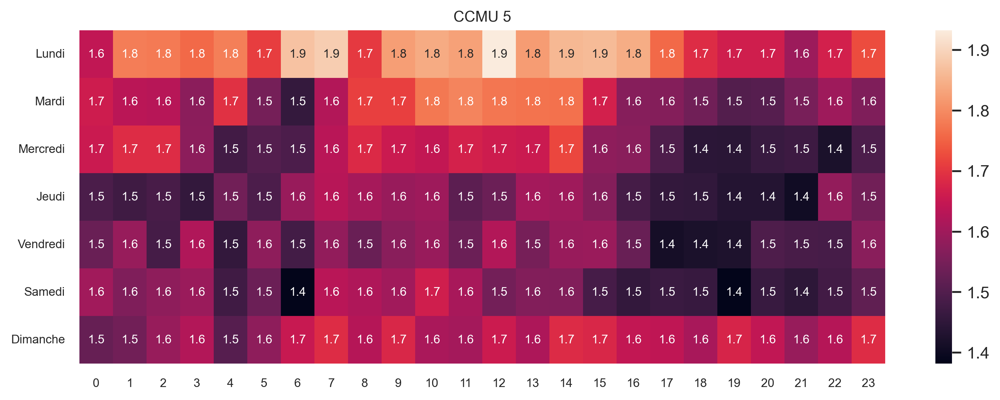

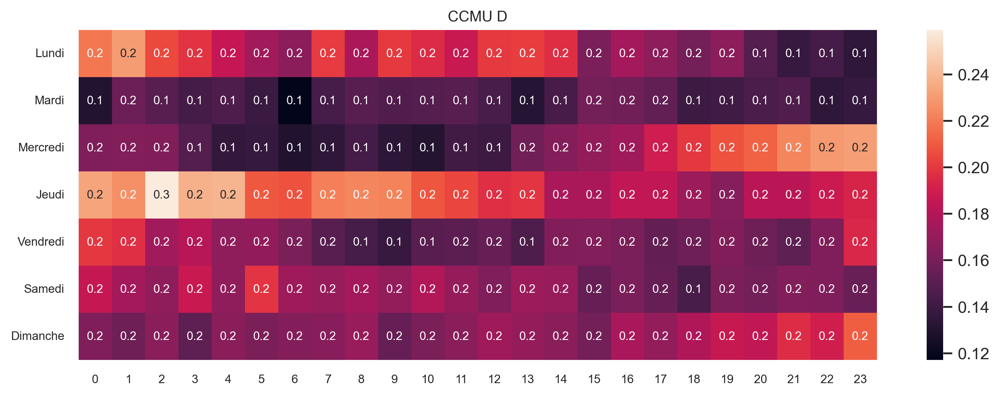

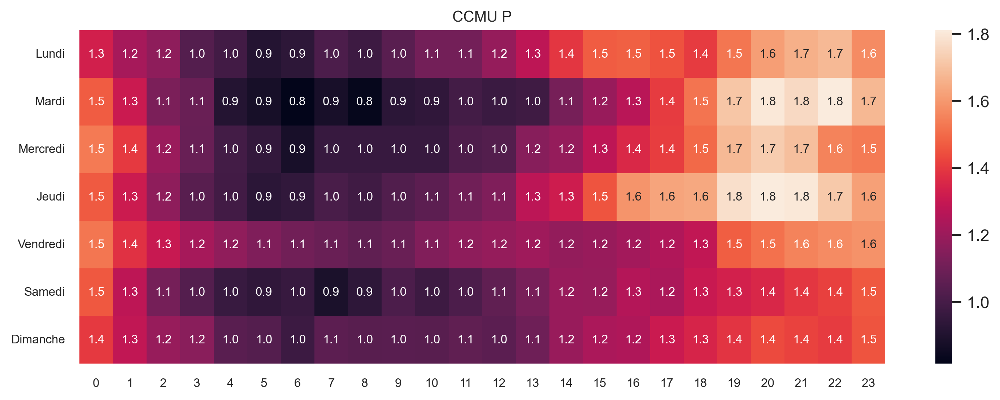

In [175]:
tension_ccmu_list = []

for i in zip(df_ccmu.columns,range(l_ccmu-4)):
    fig, ax = plt.subplots(dpi = 300) 
    tension_ccmu_list.append(pd.pivot_table(df_ccmu,index=df_ccmu.index.dayofweek,columns=df_ccmu.index.hour,
                            values=i[0],aggfunc='mean'))
    tension_ccmu_list[i[1]].index = index_dh
    
    sns.heatmap(tension_ccmu_list[i[1]], annot=True,fmt=".0f",annot_kws={"fontsize":8},xticklabels=True)
    ax.set_title("CCMU "+str(i[0]),loc='center', fontsize=10)
    ax.tick_params(axis='both', which='major', labelsize=8)
    fig.savefig(r'C:\Users\Tom\Desktop\Work Centrale\G2\IAS\Fil rouge\Cours_Filrouge_BDD\images\ccmu_dh_'+i[0]+'.png',bbox_inches='tight')
    
for i in zip(["4","5","D","P"],range(l_ccmu-4,l_ccmu)):
    fig, ax = plt.subplots(dpi = 300) 
    tension_ccmu_list.append(pd.pivot_table(df_ccmu,index=df_ccmu.index.dayofweek,columns=df_ccmu.index.hour,
                            values=i[0],aggfunc='mean'))
    tension_ccmu_list[i[1]].index = index_dh
    
    sns.heatmap(tension_ccmu_list[i[1]], annot=True,fmt=".1f",annot_kws={"fontsize":8},xticklabels=True)
    ax.set_title("CCMU "+str(i[0]),loc='center', fontsize=10)
    ax.tick_params(axis='both', which='major', labelsize=8)
    fig.savefig(r'C:\Users\Tom\Desktop\Work Centrale\G2\IAS\Fil rouge\Cours_Filrouge_BDD\images\ccmu_dh_'+i[0]+'.png',bbox_inches='tight')
    

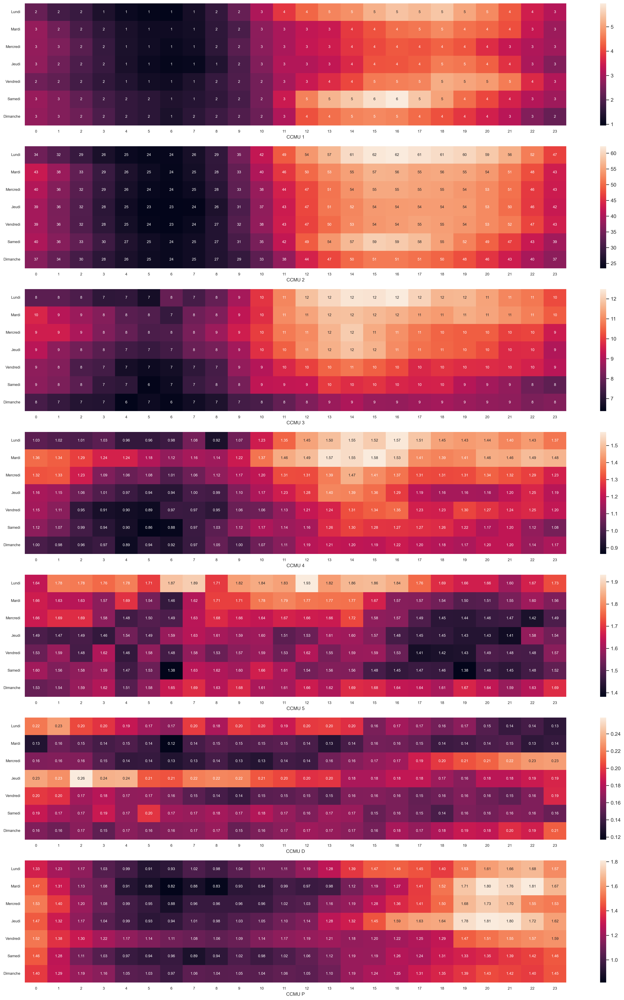

In [176]:
fig, axs = plt.subplots(nrows = l_ccmu, figsize = (21,29.7), dpi = 300) 
tension_ccmu_list = []

for i in zip(df_ccmu.columns,range(l_ccmu-4)):
    tension_ccmu_list.append(pd.pivot_table(df_ccmu,index=df_ccmu.index.dayofweek,columns=df_ccmu.index.hour,
                            values=i[0],aggfunc='mean'))
    tension_ccmu_list[i[1]].index = index_dh
    
    sns.heatmap(tension_ccmu_list[i[1]], annot=True,fmt=".0f",annot_kws={"fontsize":8},xticklabels=True, ax=axs[i[1]])
    axs[i[1]].set_xlabel("CCMU "+str(i[0]),loc='center', fontsize=10)
    axs[i[1]].tick_params(axis='both', which='major', labelsize=8)
    plt.tight_layout()
    
for i in zip(["4","5","D","P"],range(l_ccmu-4,l_ccmu)):
    tension_ccmu_list.append(pd.pivot_table(df_ccmu,index=df_ccmu.index.dayofweek,columns=df_ccmu.index.hour,
                            values=i[0],aggfunc='mean'))
    tension_ccmu_list[i[1]].index = index_dh
    
    sns.heatmap(tension_ccmu_list[i[1]], annot=True,fmt=".2f",annot_kws={"fontsize":8},xticklabels=True, ax=axs[i[1]])
    axs[i[1]].set_xlabel("CCMU "+str(i[0]),loc='center', fontsize=10)
    axs[i[1]].tick_params(axis='both', which='major', labelsize=8)
    plt.tight_layout()

In [177]:
df.to_csv("C:/Users/Tom/Desktop/Work Centrale/G2/IAS/Fil rouge/dataframe.csv", index=False)      

nb d'examens en attente par type d'examen
temps d'attente par pathologie (ddéjà fait nb fde personnes)

In [178]:
df.head()

,date_arrivee,moyen_arrivee,motif_entree,motif_venue,age,antecedents_medicaux,antecedents_chirurgicaux,pas_pad,fc,temperature,sao2,fr,ccmu,salles,entree_box,anamnese,observation,exam_biologie,exam_radiologie,exam_radiographie,exam_scanner,exam_irm,exam_avis_specialiste,date_presc_bio,date_bio,code_diag,diag_texte,cac_admission,cac_sejour,date_sortie,date_prise_charge,dossier,type_orientation,or_destination,or_trsfert_service,or_trsfert_hop,code_postal,ville,duree_sejour,duree_attente,duree_traitement,count,nb_exam,pathologie
1,2016-06-01 00:16:00,AMBULANCE PRIVEE,"Malaise, difficulté respi, palpitation, Pas de...",Cardiologie: Palpitations Malaise,33,NaN,NaN,110/56,52,"34,9",97,NaN,1,"((Attente pré IOA,01/06/2016 00:16,01/06/2016 ...",01/06/2016 01:06,MDC: Dyspnée aiguë et palpitations ATCDS: ...,NaN,oui,oui,non,non,non,non,01/06/2016 01:30,01/06/2016 01:35,R06.0,Dyspnée,ACCUEIL SURVEILLANCE ET ADMISSION URGENCE ADUL...,3093,2016-06-01 04:14:00,2016-06-01 01:03:00,NaN,RETOUR DOMICILE,RETOUR DOMICILE,NaN,NaN,59139,WATTIGNIES,0 days 03:58:00,0 days 00:47:00,0 days 03:11:00,1,2,Cardiologie
2,2016-06-01 00:18:00,AMBULANCE PRIVEE,"AEG, Hyperthermie et difficulté respi en maiso...",Maladies infectieuses: Hyperthermie,78,NaN,NaN,90/41,77,"36,3",98,NaN,2,"((Attente pré IOA,01/06/2016 00:18,01/06/2016 ...",01/06/2016 01:32,vient pour hyperthermie ATCD: DID retard ...,NaN,oui,oui,non,non,non,non,01/06/2016 01:34,01/06/2016 01:34,R50.9,"Fièvre, sans précision",ACCUEIL SURVEILLANCE ET ADMISSION URGENCE ADUL...,3102,2016-06-01 11:05:00,2016-06-01 02:14:00,NaN,TRANSFERT EXTERNE,Transfert CLINIQUE DUBOIS (LILLE) Motif: Conve...,NaN,CLINIQUE DUBOIS,59310,ORCHIES,0 days 10:47:00,0 days 01:56:00,0 days 08:51:00,1,2,Autre
3,2016-06-01 00:36:00,POMPIERS,NaN,NaN,77,NaN,NaN,137/77,97,"36,5",96,21,2,"((Attente pré IOA,01/06/2016 00:36,01/06/2016 ...",01/06/2016 00:41,NaN,NaN,non,non,non,non,non,oui,NaN,NaN,R47.1,Dysarthrie et anarthrie,ACCUEIL SURVEILLANCE ET ADMISSION URGENCE ADUL...,3102,2016-06-01 03:04:00,NaT,NaN,TRANSFERT INTERNE,Admis(e) en NEUROLOGIE B 5 EST (3281/CAC),NEUROLOGIE B 5 EST,NaN,59480,LA BASSEE,0 days 02:28:00,NaT,NaT,1,1,Autre
4,2016-06-01 00:43:00,MOYENS PERSONNELS,"1A, Hyperthermie ne cédant pas au paracetamol,...",Maladies infectieuses: Hyperthermie,38,NaN,NaN,117/71,118,"38,2",98,NaN,1,"((Attente pré IOA,01/06/2016 00:43,01/06/2016 ...",01/06/2016 01:36,patient de 38 ans appelant le SAMU pour épisod...,NaN,oui,non,non,non,non,non,01/06/2016 01:40,01/06/2016 01:40,L98.8,Autres affections précisées de la peau et du t...,ACCUEIL SURVEILLANCE ET ADMISSION URGENCE ADUL...,3093,2016-06-01 04:50:00,2016-06-01 01:57:00,NaN,RETOUR DOMICILE,RETOUR DOMICILE,NaN,NaN,59136,WAVRIN,0 days 04:07:00,0 days 01:14:00,0 days 02:53:00,1,1,Autre
5,2016-06-01 01:16:00,AMBULANCE PRIVEE,"Douleur bras gauche et mollet gauche, hémiplég...",Cardiologie: Phlébite,69,décembre 2007 : infarctus capsulo caudé droit ...,NaN,137/79,70,"36,1",97,NaN,2,"((Attente pré IOA,01/06/2016 01:16,01/06/2016 ...",01/06/2016 01:36,Patiente de 69 ans amenée pour douleur membre ...,NaN,oui,non,non,non,non,oui,01/06/2016 01:34,01/06/2016 01:35,M79.62,Douleur au niveau d'un membre - Bras,ACCUEIL SURVEILLANCE ET ADMISSION URGENCE ADUL...,3102,2016-06-01 15:55:00,2016-06-01 02:35:00,NaN,RETOUR DOMICILE,RETOUR DOMICILE,NaN,NaN,59130,LAMBERSART,0 days 14:39:00,0 days 01:19:00,0 days 13:20:00,1,2,Cardiologie


In [179]:
df_t = df.copy()
df_t["duree_attente"] = df_t.duree_attente/datetime.timedelta(hours=1)

In [180]:
df_t = df_t[df_t.duree_attente < 12]


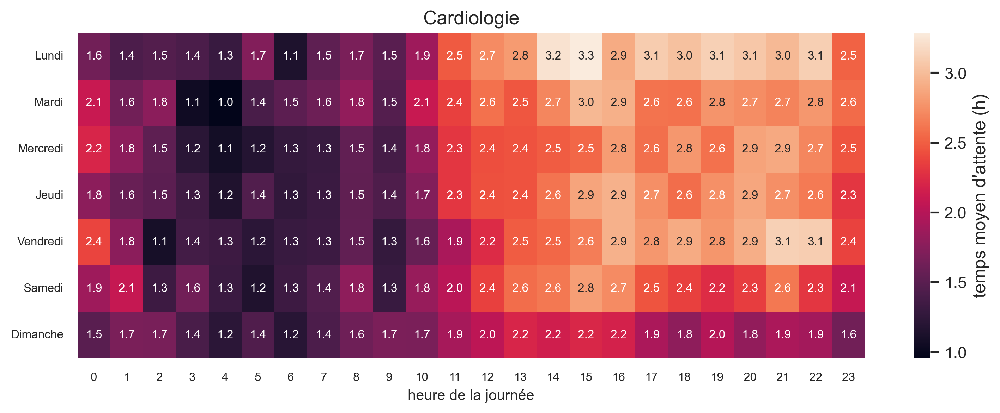

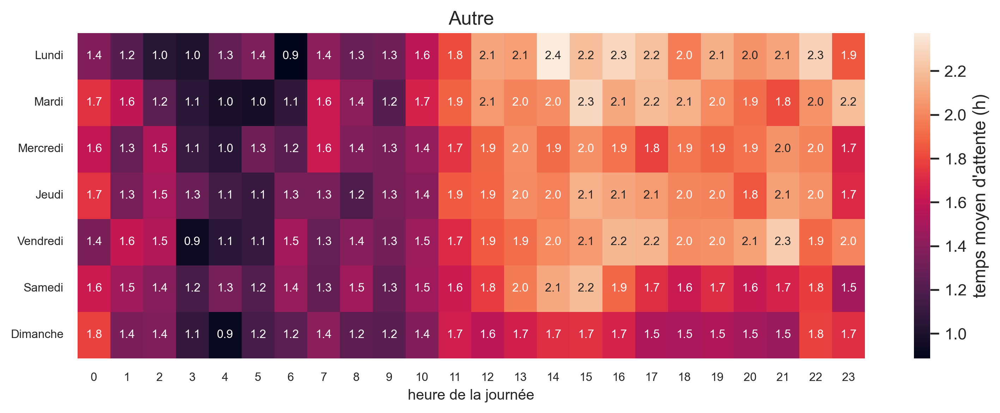

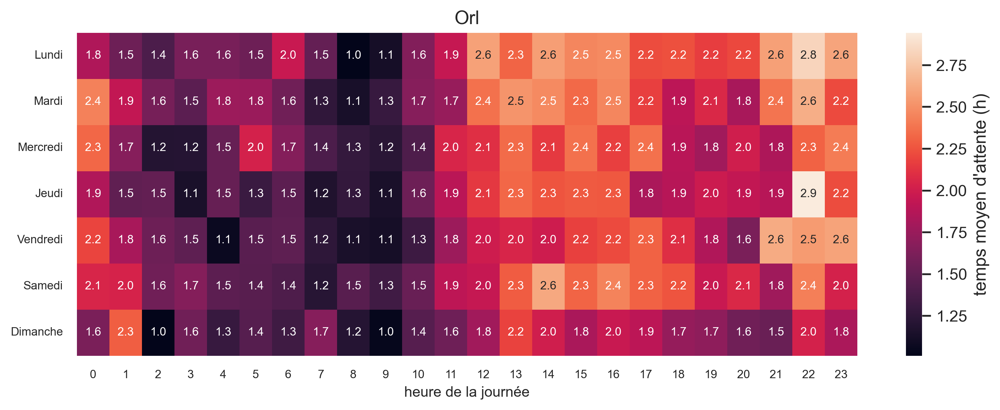

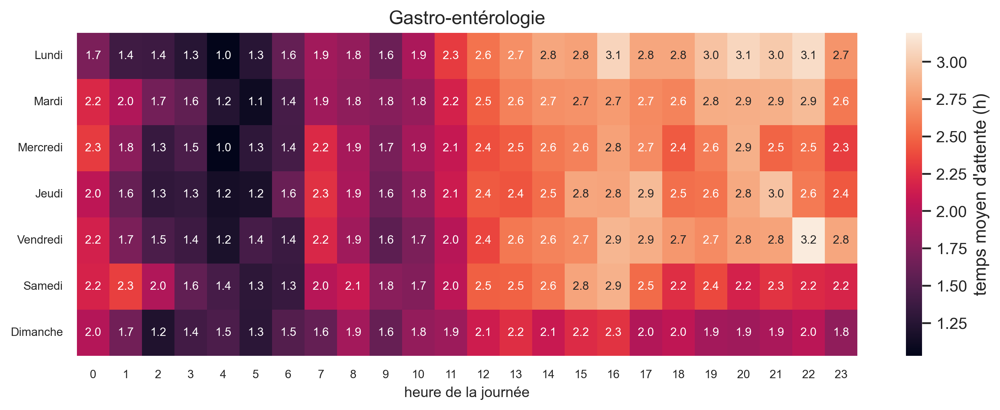

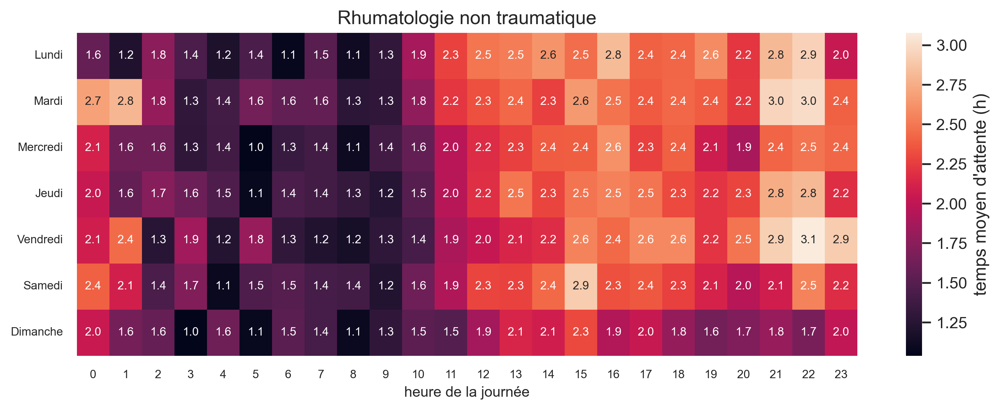

...

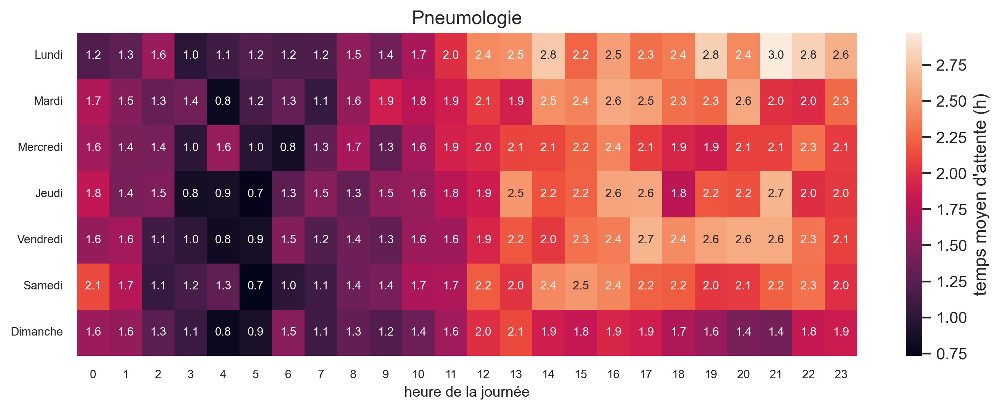

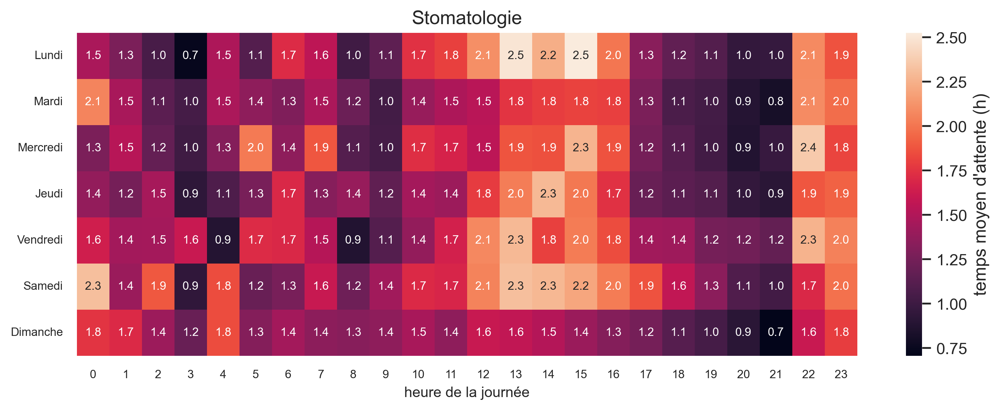

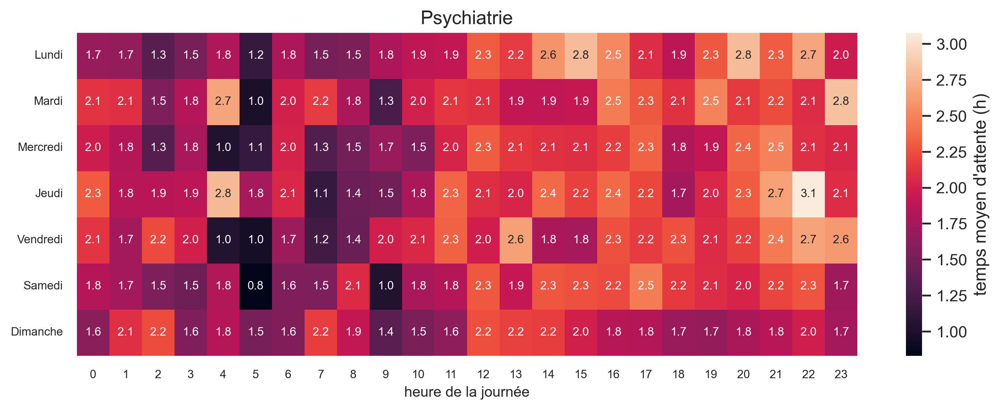

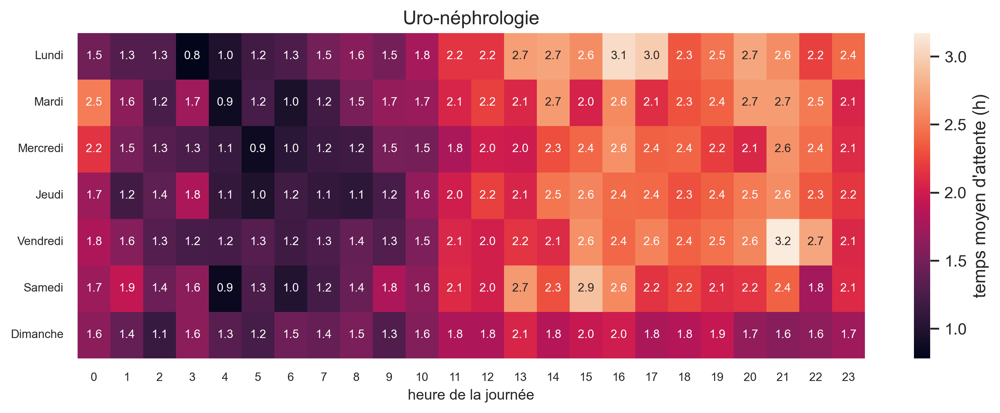

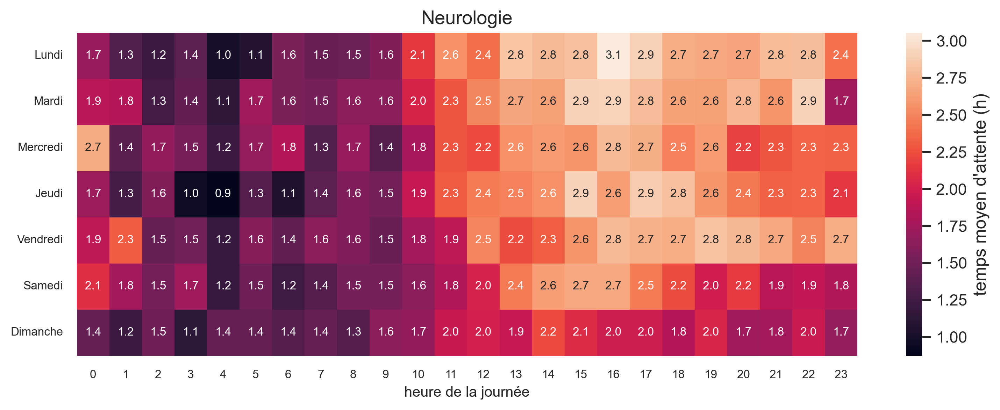

In [181]:
tension_path_list = []
for i in zip(df.pathologie.unique(),range(l)):
    fig, ax = plt.subplots(dpi = 300) 
    tension_path_list.append(pd.pivot_table(df_t[df_t.pathologie==i[0]],index=df_t.date_arrivee.dt.dayofweek,columns=df_t.date_arrivee.dt.hour,
                            values="duree_attente",aggfunc='mean'))
    tension_path_list[i[1]].index = index_dh
    
    sns.heatmap(tension_path_list[i[1]], annot=True,fmt=".1f",annot_kws={"fontsize":8},xticklabels=True,cbar_kws={'label': "temps moyen d'attente (h)"})
    ax.set_title(i[0],loc='center', fontsize=13)
    ax.set_xlabel("heure de la journée",loc='center', fontsize=10)
    ax.tick_params(axis='both', which='major', labelsize=8)
    fig.savefig(r'C:\Users\Tom\Desktop\Work Centrale\G2\IAS\Fil rouge\Cours_Filrouge_BDD\images\pathologies_attente_dh_'+i[0]+'.png',bbox_inches='tight')


In [182]:
df.pathologie.unique()

array(['Cardiologie', 'Autre', 'Orl', 'Gastro-entérologie',
       'Rhumatologie non traumatique', 'Traumatologie', 'Pneumologie',
       'Stomatologie', 'Psychiatrie', 'Uro-néphrologie', 'Neurologie'],
      dtype=object)

In [183]:
df[(df.ccmu == "4")].head(30)

,date_arrivee,moyen_arrivee,motif_entree,motif_venue,age,antecedents_medicaux,antecedents_chirurgicaux,pas_pad,fc,temperature,sao2,fr,ccmu,salles,entree_box,anamnese,observation,exam_biologie,exam_radiologie,exam_radiographie,exam_scanner,exam_irm,exam_avis_specialiste,date_presc_bio,date_bio,code_diag,diag_texte,cac_admission,cac_sejour,date_sortie,date_prise_charge,dossier,type_orientation,or_destination,or_trsfert_service,or_trsfert_hop,code_postal,ville,duree_sejour,duree_attente,duree_traitement,count,nb_exam,pathologie
154,2016-06-01 17:18:00,AMBULANCE PRIVEE,NaN,NaN,87,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4,"((Attente pré IOA,01/06/2016 17:18,01/06/2016 ...",01/06/2016 17:27,NaN,NaN,oui,non,non,non,non,non,01/06/2016 17:28,01/06/2016 17:29,I64,"Accident vasculaire cérébral, non précisé comm...",ACCUEIL SURVEILLANCE ET ADMISSION URGENCE ADUL...,3102,2016-06-01 20:29:00,2016-06-01 20:28:00,NaN,TRANSFERT INTERNE,Admis(e) en SOINS INTENSIFS NEUROVASCULAIRES (...,SOINS INTENSIFS NEUROVASCULAIRES,NaN,59000,LILLE,0 days 03:11:00,0 days 03:10:00,0 days 00:01:00,1,1,Autre
345,2016-06-02 15:40:00,MOYENS PERSONNELS,hemetemese + melena ( atcdt +++++),Gastro-entérologie: Hémorragie digestive non a...,48,- HTA - Dyslipidémie - Embolie pulmonaire en...,- Cholécystectomie en 2013 - Dérivation bilio...,125/59,78,"35,8",100,NaN,4,"((Attente pré IOA,02/06/2016 15:40,02/06/2016 ...",02/06/2016 15:53,TTT : escitalopram 1-0-0 Temesta 2.5 : 1-1-...,NaN,oui,non,non,non,non,non,02/06/2016 16:08,02/06/2016 16:08,E87.60,"Hypokaliémie inférieure à 2,5 millimoles [mmol...",ACCUEIL SURVEILLANCE ET ADMISSION URGENCE ADUL...,3102,2016-06-02 18:40:00,2016-06-02 16:50:00,NaN,TRANSFERT INTERNE,Admis(e) en SOINS INTENSIFS UADM (5349/CAC),SOINS INTENSIFS UADM,NaN,59229,TETEGHEM,0 days 03:00:00,0 days 01:10:00,0 days 01:50:00,1,1,Gastro-entérologie
346,2016-06-02 15:41:00,AMBULANCE PRIVEE,Malaise sans pci+vomissement+ cervicalgies et ...,Cardiologie: Malaise,54,NaN,NaN,152/71,81,"36,3",95,NaN,4,"((Attente pré IOA,02/06/2016 15:41,02/06/2016 ...",02/06/2016 15:53,"Motif: douleur épigastrique, vomissements, cer...",NaN,oui,non,non,oui,non,oui,02/06/2016 16:25,02/06/2016 16:25,I60.8,Autres hémorragies sous-arachnoïdiennes,ACCUEIL SURVEILLANCE ET ADMISSION URGENCE ADUL...,3082,2016-06-03 03:12:00,2016-06-02 18:39:00,NaN,TRANSFERT INTERNE,Admis(e) en RÉANIMATION (3820/CAC),RÉANIMATION,NaN,59000,LILLE,0 days 11:31:00,0 days 02:58:00,0 days 08:33:00,1,3,Cardiologie
437,2016-06-03 01:04:00,SAMU-SMUR,NaN,NaN,53,NaN,NaN,116/65,63,"36,1",98,13,4,"((Attente,03/06/2016 01:04,03/06/2016 01:25),(...",NaN,Patient de 53 ans Transfert de valenciennes ...,NaN,non,non,non,non,non,oui,NaN,NaN,I60.8,Autres hémorragies sous-arachnoïdiennes,ANEST RÉA SOINS INTENSIFS (3082/CAC),3082,2016-06-03 17:25:00,2016-06-03 01:28:00,NaN,TRANSFERT INTERNE,Admis(e) en NEURO-CHIRURGIE UF E NORD (3805/CAC),NEURO-CHIRURGIE UF E NORD,NaN,59530,POTELLE,0 days 16:21:00,0 days 00:24:00,0 days 15:57:00,1,1,Autre
526,2016-06-03 13:32:00,AMBULANCE PRIVEE,anemie Hb a 6 ( saignement au niveau de la ...,Hématologie: Anémie < 8 g/dl sans saignement a...,67,adénocarcinome rectal opéré en 1990 avec colos...,NaN,96/44,80,"35,7",100,NaN,4,"((Attente pré IOA,03/06/2016 13:32,03/06/2016 ...",NaN,"ATCD colostomie definitive, cirrhose, varices ...",NaN,oui,non,non,non,non,oui,04/06/2016 10:15,04/06/2016 10:15,NaN,NaN,ACCUEIL SURVEILLANCE ET ADMISSION URGENCE ADUL...,3082,2016-06-04 19:15:00,2016-06-03 15:19:00,NaN,TRANSFERT INTERNE,Admis(e) en MÉDECINE UNITÉ BENHAMOU (1441/CAC),MÉDECINE UNITÉ BENHAMOU,NaN,59184,SAINGHIN EN WEPPES,1 days 05:43:00,0 days 01:47:00,1 days 03:56:00,1,2,Autre
621,2016-06-03 20:18:00,SAMU-SMUR,NaN,NaN,45,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4,"((Attente,03/06/2016 20:18,03/06/2016 20:34),(...",NaN,"homme de 45ans, chute d'echelle de 1.5m avec P...",NaN,non,non,non,oui,non,oui,NaN,NaN,S06.5,Hémorragie sous-durale traumatique,ANEST RÉA SOINS INTENSIFS (3082/CAC),3082,2016-06-04 00:29:00,2016-06-03 20:33:00,Na

In [184]:
df[(df.ccmu == "4") | (df.ccmu == "5")].or_trsfert_service.value_counts()[:20]

SOINS INTENSIFS UADM                                  799
SOINS INTENSIFS NEUROVASCULAIRES                      655
RÉANIMATION                                           485
SOINS INTENSIFS                                       375
RÉANIMATION CHIRURGICALE                              199
NEURO-CHIRURGIE UF E NORD                              88
NEURO-CHIRURGIE UF A OUEST                             80
HOSPITALISATION COURTE DURÉE                           70
TRAUMATOLOGIE                                          66
SURV.CONTINUE CHIR ADULTE POST RÉA                     60
NEURO-CHIRURGIE UF D EST                               59
HOSPITALISATION COMPLÈTE                               50
NEURO-CHIRURGIE UF B NORD                              45
TRAUMATOLOGIE 5 SUD                                    42
NEUROLOGIE B 5 EST                                     38
MÉDECINE GÉRIATRIQUE SUD (EX SALENGRO)                 36
SURVEILLANCE CONTINUE CAO                              36
SOINS INTENSIF

In [185]:
df[(df.ccmu == "4") | (df.ccmu == "5")].cac_admission.value_counts()

ACCUEIL SURVEILLANCE ET ADMISSION URGENCE ADULTE (3093/CAC)    2588
ANEST RÉA SOINS INTENSIFS (3082/CAC)                           1860
HCD URGENCE CHIR ET SOINS PÉRI-OP (3095/CAC)                     39
URGENCE CIRCUIT COURT (3088/CAC)                                 36
ACCUEIL TRI ORIENTATION ZAO URGENCE (3098/CAC)                   22
BLOC DES URGENCES (3089/CAC)                                     22
HCD URGENCE ACCUEIL MÉDICO CHIRURGICAL (3102/CAC)                15
URGENCE PÉDIATRIQUE CONSULTATIONS (3091/CAC)                     14
U.H.C.D. URGENCE PÉDIATRIQUE (3092/CAC)                           3
HCD HÉBERGEMENT (3097/CAC)                                        1
HOSP.COMPL.URGENCE CHIRURGIE (3084/CAC)                           1
HOSP.COMPL.URGENCE MÉDECINE (3083/CAC)                            1
Name: cac_admission, dtype: int64

In [186]:
df.or_destination.head(50)

1                                       RETOUR DOMICILE
2     Transfert CLINIQUE DUBOIS (LILLE) Motif: Conve...
3             Admis(e) en NEUROLOGIE B 5 EST (3281/CAC)
4                                       RETOUR DOMICILE
5                                       RETOUR DOMICILE
6                                       RETOUR DOMICILE
7                                       RETOUR DOMICILE
8                                       RETOUR DOMICILE
9                                       RETOUR DOMICILE
10                                      RETOUR DOMICILE
11                                      RETOUR DOMICILE
12                                      RETOUR DOMICILE
13                                      RETOUR DOMICILE
14                                          CONTRE AVIS
15                                      RETOUR DOMICILE
16                                      RETOUR DOMICILE
17                                 PARTIE SANS ATTENDRE
18    Admis(e) en SOINS INTENSIFS NEUROVASCULAIR

In [187]:
df.or_destination.value_counts()[:20]

RETOUR DOMICILE                                                              237648
NON PRIS EN CHARGE                                                            10705
PARTIE SANS ATTENDRE                                                           7241
Admis(e) en SOINS INTENSIFS NEUROVASCULAIRES (3303/CAC)                        3347
Admis(e) en MÉDECINE POLYVALENTE POST URGENCE (2250/CAC)                       3232
Admis(e) en SOINS INTENSIFS UADM (5349/CAC)                                    3088
Admis(e) en TRAUMATOLOGIE 5 SUD (3960/CAC)                                     2692
Admis(e) en MÉDECINE GÉRIATRIQUE OUEST (EX CARDIO) (3715/CAC)                  2574
Admis(e) en SOINS INTENSIFS (7643/CAC)                                         2270
Admis(e) en MÉDECINE GÉRIATRIQUE SUD (EX SALENGRO) (3711/CAC)                  2246
Admis(e) en NEUROLOGIE A 4 NORD HC HPDD EXPLORATIONS ÉPILEPSIE (3271/CAC)      2001
CONTRE AVIS                                                                 

In [188]:
afe = df.or_destination.str.contains("UHCD")

In [189]:
afe[afe == True]

Series([], Name: or_destination, dtype: bool)

In [190]:
df.type_orientation.value_counts()[:20]

RETOUR DOMICILE         239554
TRANSFERT INTERNE        67311
NON PRIS EN CHARGE       10705
PARTIE SANS ATTENDRE      7241
TRANSFERT EXTERNE         6792
CONTRE AVIS               1907
FUGUE                     1560
DECES                     1116
POLICE                      67
Name: type_orientation, dtype: int64

In [191]:
data_IDE =[]
for i in range(8) : data_IDE.append(5)
for i in range(15) :data_IDE.append(6)
data_IDE.append(5)
pres_IDE = pd.Series(index = range(24), data = data_IDE)
pres_IDE = pres_IDE.to_frame().transpose()
for i in range(6):
    pres_IDE = pres_IDE.append(pres_IDE.iloc[0])
pres_IDE.index = index_dh
charge_IDE = tension_day_hour/pres_IDE

C:\Users\Tom\AppData\Local\Temp\ipykernel_2288\2303755561.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pres_IDE = pres_IDE.append(pres_IDE.iloc[0])
C:\Users\Tom\AppData\Local\Temp\ipykernel_2288\2303755561.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pres_IDE = pres_IDE.append(pres_IDE.iloc[0])
C:\Users\Tom\AppData\Local\Temp\ipykernel_2288\2303755561.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pres_IDE = pres_IDE.append(pres_IDE.iloc[0])
C:\Users\Tom\AppData\Local\Temp\ipykernel_2288\2303755561.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pres_IDE = pres_IDE.append(pres_IDE.iloc[0])
C:\Users\Tom\AppData\Loc

In [192]:
charge_IDE

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23
Lundi,13.932097,13.208287,12.497450,11.743408,11.357418,11.160852,11.354200,11.707235,10.432402,11.782174,13.536840,15.128266,16.356642,17.288232,17.872861,18.115579,18.114698,17.847403,17.703569,17.514128,17.282090,16.839438,15.869467,17.753541
Mardi,16.534506,15.383490,13.955340,13.037773,12.166549,11.830478,11.668323,11.874080,10.556320,11.718312,13.314646,14.553148,15.481744,16.170847,16.460380,16.713455,16.701512,16.381171,16.505061,16.490269,16.285709,15.905351,15.050955,16.881361
Mercredi,15.938515,14.850127,13.684586,12.669836,11.976807,11.672776,11.430998,11.705960,10.488168,11.573196,12.803385,14.042333,14.899517,15.645953,16.157284,16.290842,16.120273,15.943289,15.901576,15.896318,15.612095,15.244253,14.377205,16.404370
Jeudi,15.378311,14.285465,13.320647,12.417336,11.564417,11.268382,11.211562,11.313410,10.100016,11.193406,12.594473,13.877126,14.815909,15.621904,15.842818,16.107696,16.104302,16.018947,16.041394,16.006511,15.707341,15.239178,14.253379,16.104367
Vendredi,15.133890,14.222480,13.092472,12.300909,11.665572,11.233503,11.185134,11.387324,10.118264,11.187793,12.449394,13.666354,14.541379,15.344486,15.650322,15.762561,15.670845,15.679262,15.768270,15.725646,15.542958,15.381051,14.397109,16.251747
Samedi,15.337949,14.386789,13.382440,12.486040,11.838303,11.459928,11.052231,11.301627,9.920639,10.813850,11.867408,13.285161,14.828265,15.869218,16.411990,16.834720,16.692643,16.247130,15.730363,15.020653,14.529375,14.005178,13.140766,14.856290
Dimanche,14.168659,13.392952,12.593097,11.817134,11.403758,11.140395,10.992730,11.177573,9.719989,10.212163,11.108867,12.198989,13.589857,14.420514,14.802450,15.018370,15.018499,14.826952,14.620485,14.349294,13.895390,13.405495,12.692801,14.516261


In [193]:
data_med = []
for i in range(8) : data_med.append(10)
for i in range(15) :data_med.append(21)
data_med.append(10)

In [194]:
print(data_med)

[10, 10, 10, 10, 10, 10, 10, 10, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 10]


In [195]:
len(data_med)

24

In [196]:
pres_medecin = pd.Series(index = range(24), data = data_med)

In [197]:
pres_medecin

0     10
1     10
2     10
3     10
4     10
5     10
6     10
7     10
8     21
9     21
10    21
11    21
12    21
13    21
14    21
15    21
16    21
17    21
18    21
19    21
20    21
21    21
22    21
23    10
dtype: int64

In [198]:
tension_day_hour.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23
Lundi,69.660484,66.041433,62.487248,58.717040,56.787091,55.804260,56.771000,58.536177,62.594415,70.693042,81.221039,90.769599,98.139854,103.729393,107.237168,108.693472,108.688187,107.084419,106.221417,105.084769,103.692537,101.036627,95.216804,88.767704
Mardi,82.672530,76.917450,69.776699,65.188865,60.832743,59.152390,58.341615,59.370399,63.337921,70.309872,79.887878,87.318888,92.890466,97.025084,98.762281,100.280731,100.209071,98.287025,99.030364,98.941612,97.714253,95.432108,90.305727,84.406804
Mercredi,79.692577,74.250634,68.422931,63.349178,59.884037,58.363879,57.154989,58.529801,62.929011,69.439175,76.820309,84.253995,89.397103,93.875719,96.943701,97.745053,96.721641,95.659734,95.409454,95.377911,93.672572,91.465517,86.263231,82.021850
Jeudi,76.891557,71.427326,66.603235,62.086682,57.822086,56.341912,56.057809,56.567050,60.600097,67.160438,75.566840,83.262756,88.895452,93.731426,95.056911,96.646176,96.625809,96.113685,96.248366,96.039067,94.244048,91.435070,85.520276,80.521833
Vendredi,75.669450,71.112398,65.462361,61.504545,58.327858,56.167517,55.925669,56.936620,60.709586,67.126756,74.696362,81.998124,87.248276,92.066917,93.901931,94.575368,94.025069,94.075573,94.609621,94.353874,93.257750,92.286307,86.382656,81.258734


In [199]:
pres_medecin = pres_medecin.to_frame()

In [200]:
pres_medecin = pres_medecin.transpose()

In [201]:
for i in range(6):
    pres_medecin = pres_medecin.append(pres_medecin.iloc[0])

C:\Users\Tom\AppData\Local\Temp\ipykernel_2288\487525799.py:2: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pres_medecin = pres_medecin.append(pres_medecin.iloc[0])
C:\Users\Tom\AppData\Local\Temp\ipykernel_2288\487525799.py:2: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pres_medecin = pres_medecin.append(pres_medecin.iloc[0])
C:\Users\Tom\AppData\Local\Temp\ipykernel_2288\487525799.py:2: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pres_medecin = pres_medecin.append(pres_medecin.iloc[0])
C:\Users\Tom\AppData\Local\Temp\ipykernel_2288\487525799.py:2: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pres_medecin = pres_medecin.append(pr

In [202]:
pres_medecin.index = index_dh

In [203]:
pres_medecin

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23
Lundi,10,10,10,10,10,10,10,10,21,21,21,21,21,21,21,21,21,21,21,21,21,21,21,10
Mardi,10,10,10,10,10,10,10,10,21,21,21,21,21,21,21,21,21,21,21,21,21,21,21,10
Mercredi,10,10,10,10,10,10,10,10,21,21,21,21,21,21,21,21,21,21,21,21,21,21,21,10
Jeudi,10,10,10,10,10,10,10,10,21,21,21,21,21,21,21,21,21,21,21,21,21,21,21,10
Vendredi,10,10,10,10,10,10,10,10,21,21,21,21,21,21,21,21,21,21,21,21,21,21,21,10
Samedi,10,10,10,10,10,10,10,10,21,21,21,21,21,21,21,21,21,21,21,21,21,21,21,10
Dimanche,10,10,10,10,10,10,10,10,21,21,21,21,21,21,21,21,21,21,21,21,21,21,21,10


In [204]:
charge_mdc = tension_day_hour/pres_medecin

In [205]:
charge_mdc

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23
Lundi,6.966048,6.604143,6.248725,5.871704,5.678709,5.580426,5.677100,5.853618,2.980686,3.366335,3.867669,4.322362,4.673326,4.939495,5.106532,5.175880,5.175628,5.099258,5.058163,5.004037,4.937740,4.811268,4.534134,8.876770
Mardi,8.267253,7.691745,6.977670,6.518886,6.083274,5.915239,5.834161,5.937040,3.016091,3.348089,3.804185,4.158042,4.423356,4.620242,4.702966,4.775273,4.771861,4.680335,4.715732,4.711505,4.653060,4.544386,4.300273,8.440680
Mercredi,7.969258,7.425063,6.842293,6.334918,5.988404,5.836388,5.715499,5.852980,2.996620,3.306627,3.658110,4.012095,4.257005,4.470272,4.616367,4.654526,4.605792,4.555225,4.543307,4.541805,4.460599,4.355501,4.107773,8.202185
Jeudi,7.689156,7.142733,6.660324,6.208668,5.782209,5.634191,5.605781,5.656705,2.885719,3.198116,3.598421,3.964893,4.233117,4.463401,4.526520,4.602199,4.601229,4.576842,4.583256,4.573289,4.487812,4.354051,4.072394,8.052183
Vendredi,7.566945,7.111240,6.546236,6.150455,5.832786,5.616752,5.592567,5.693662,2.890933,3.196512,3.556970,3.904673,4.154680,4.384139,4.471521,4.503589,4.477384,4.479789,4.505220,4.493042,4.440845,4.394586,4.113460,8.125873
Samedi,7.668974,7.193395,6.691220,6.243020,5.919151,5.729964,5.526116,5.650813,2.834468,3.089671,3.390688,3.795760,4.236647,4.534062,4.689140,4.809920,4.769327,4.642037,4.494389,4.291615,4.151250,4.001479,3.754505,7.428145
Dimanche,7.084330,6.696476,6.296549,5.908567,5.701879,5.570198,5.496365,5.588787,2.777140,2.917761,3.173962,3.485426,3.882816,4.120147,4.229271,4.290963,4.291000,4.236272,4.177281,4.099798,3.970111,3.830141,3.626515,7.258131


<AxesSubplot:>

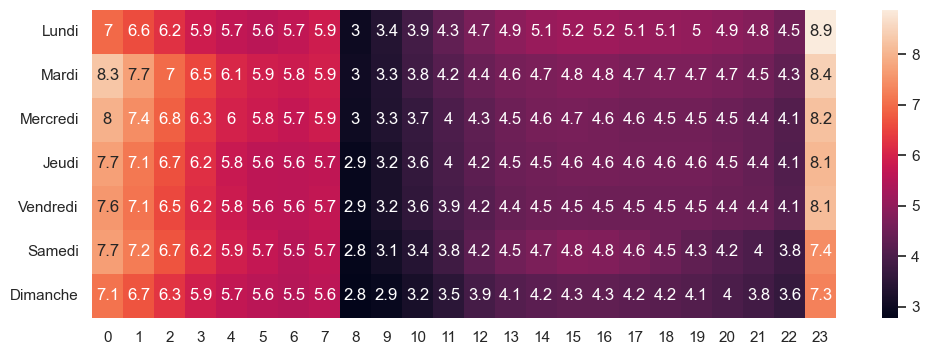

In [206]:
sns.heatmap(charge_mdc,annot=True)

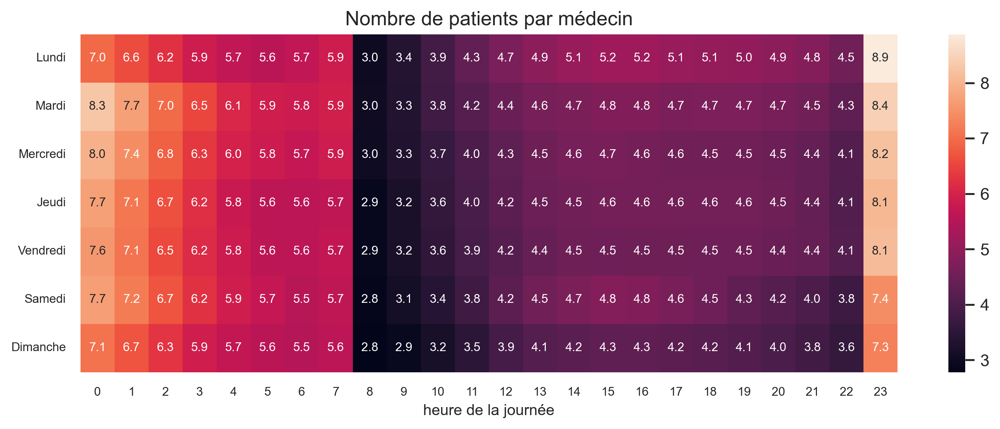

In [207]:
fig, ax = plt.subplots(dpi = 300) 
sns.heatmap(charge_mdc, annot=True,fmt=".1f",annot_kws={"fontsize":8},xticklabels=True)
ax.set_title("Nombre de patients par médecin",loc='center', fontsize=13)
ax.set_xlabel("heure de la journée",loc='center', fontsize=10)
ax.tick_params(axis='both', which='major', labelsize=8)
fig.savefig(r'C:\Users\Tom\Desktop\Work Centrale\G2\IAS\Fil rouge\Cours_Filrouge_BDD\images\charge_mdc.png',bbox_inches='tight')
    

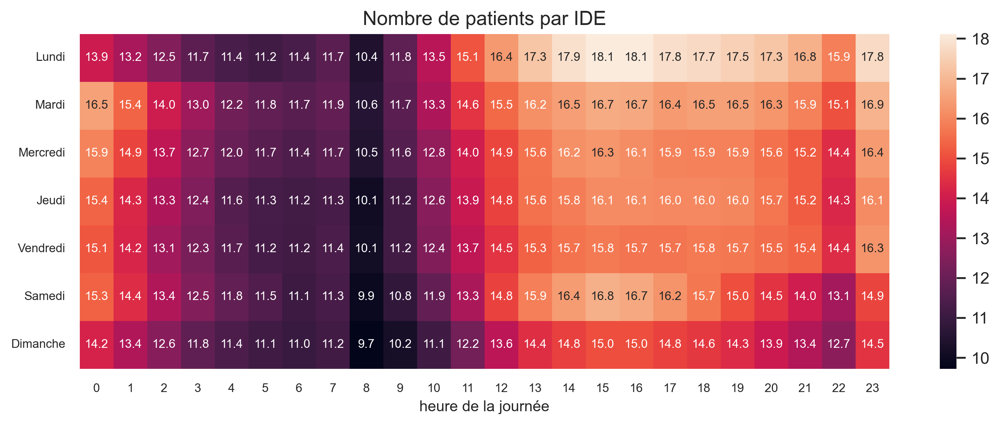

In [208]:
fig, ax = plt.subplots(dpi = 300) 
sns.heatmap(charge_IDE, annot=True,fmt=".1f",annot_kws={"fontsize":8},xticklabels=True)
ax.set_title("Nombre de patients par IDE",loc='center', fontsize=13)
ax.set_xlabel("heure de la journée",loc='center', fontsize=10)
ax.tick_params(axis='both', which='major', labelsize=8)
fig.savefig(r'C:\Users\Tom\Desktop\Work Centrale\G2\IAS\Fil rouge\Cours_Filrouge_BDD\images\charge_IDE.png',bbox_inches='tight')
    